In [1]:
import IPython.display
import PIL.Image
def imshow(x):
  IPython.display.display(PIL.Image.fromarray(x))

def img_to_data_uri(img, format='png', jpeg_quality=75):
  """Given a numpy array `img`, return a `data:` URI suitable for use in 
  an HTML image tag."""

  from io import BytesIO
  out = BytesIO()

  import imageio
  kwargs = dict(format=format)
  if format == 'jpg':
    kwargs.update(quality=jpeg_quality)
  imageio.imwrite(out, img, **kwargs)

  from base64 import b64encode
  data = b64encode(out.getvalue()).decode('ascii')
  
  from six.moves.urllib import parse
  data_url = 'data:image/png;base64,{}'.format(parse.quote(data))
  
  return data_url

# Based upon https://github.com/opencv/opencv/blob/master/samples/python/opt_flow.py
import cv2
import numpy as np
def draw_flow(img, flow, step=8):
    h, w = img.shape[:2]
    y, x = np.mgrid[step/2:h:step, step/2:w:step].reshape(2,-1).astype(int)
    fx, fy = flow[y,x].T
    lines = np.vstack([x, y, x+fx, y+fy]).T.reshape(-1, 2, 2)
    lines = np.int32(lines + 0.5)
    vis = img.copy()
    cv2.polylines(vis, lines, 0, (0, 255, 0))
    for (x1, y1), (_x2, _y2) in lines:
        cv2.circle(vis, (x1, y1), 1, (0, 255, 0), -1)
    return vis

def warp_flow_backwards(img, flow):
    h, w = flow.shape[:2]
    flow = -flow
    flow[:,:,0] += np.arange(w)
    flow[:,:,1] += np.arange(h)[:,np.newaxis]
    res = cv2.remap(img, flow.astype(np.float32), None, cv2.INTER_LINEAR)
    return res
    
# https://stackoverflow.com/questions/41703210/inverting-a-real-valued-index-grid/46009462#46009462
def warp_flow_forwards(img, flow):
    h, w = img.shape[:2]
    pts = flow.copy()
    pts[:, :, 0] += np.arange(w)
    pts[:, :, 1] += np.arange(h)[:,np.newaxis]
    exclude = (flow[:, :, :2] == np.array([0, 0])).all(axis=-1)
    if exclude.all():
        print('no flow!')
        return img.copy(), np.zeros((h, w)).astype(np.bool)
    else:
        inpts = pts[~exclude]
#     outpts = pts[exclude]
    
    from scipy.interpolate import griddata
    inpts = np.reshape(inpts, [-1, 2])
    grid_y, grid_x = np.mgrid[:h, :w]
    chan_out = []
    for ch in range(img.shape[-1]):
        spts = img[:, :, ch][~exclude].reshape([-1, 1])
        mapped = griddata(inpts, spts, (grid_x, grid_y), method='linear')
        chan_out.append(mapped.astype(img.dtype))
    out = np.stack(chan_out, axis=-1)
    out = out.reshape([h, w, len(chan_out)])

    mask = np.reshape(inpts, [-1, 2])
    mask = np.rint(mask).astype(np.int)
    mask = mask[np.where((mask[:, 0] >= 0) & (mask[:, 0] < w) & (mask[:, 1] >= 0) & (mask[:, 1] < h))]
    valid_mask = np.zeros((h, w))
    valid_mask[mask[:, 1], mask[:, 0]] = 1
    
    return out, valid_mask.astype(np.bool)

def mse(i1, i2, valid):
    return np.mean((i1[valid] - i2[valid]) ** 2)

def rmse(i1, i2, valid):
    import math
    return math.sqrt(mse(i1, i2, valid))

def psnr(i1, i2, valid):
    import math
    return -10 * math.log10(max(mse(i1, i2, valid), 1e-12))

def ssim(i1, i2, valid):
    # Some variance out there ...
    # https://github.com/scikit-image/scikit-image/blob/master/skimage/metrics/_structural_similarity.py#L12-L232
    # https://github.com/nianticlabs/monodepth2/blob/13200ab2f29f2f10dec3aa5db29c32a23e29d376/layers.py#L218
    # https://cvnote.ddlee.cn/2019/09/12/psnr-ssim-python
    from skimage.metrics import structural_similarity as ssim
    mssim, S = ssim(i1, i2, win_size=11, multichannel=True, full=True)
    return np.mean(S[valid])

def to_edge_im(img):
    return np.stack([
        cv2.Laplacian(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), cv2.CV_32F, ksize=1),
        cv2.Sobel(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), cv2.CV_32F, 1, 0, ksize=3),
        cv2.Sobel(cv2.cvtColor(img, cv2.COLOR_RGB2GRAY), cv2.CV_32F, 0, 1, ksize=3),
    ], axis=-1)
def edges_mse(i1, i2, valid):
    return mse(to_edge_im(i1), to_edge_im(i2), valid)

def show_scene(im1, im2, flow, dataset='', exname=''):
    print()
    print('flow')
    vis = draw_flow(im1, flow)
    imshow(vis)
    print('input')
    imshow(im1)
    print('expected')
    imshow(im2)

    print()
    print()
    print('forwards')

    print('forwards warped')
    warped, valid_mask = warp_flow_forwards(im1, flow)
    vwarped = warped.copy()
    if (~valid_mask).any():
        vwarped[~valid_mask] = im2[~valid_mask]#np.array([255, 0, 0])
    else:
        vwarped = im2.copy()
        print('!!!! no invalids')
    imshow(vwarped)
    
    print('expected')
    fexpected = im2.copy()
#     fexpected[~valid_mask] = np.array([255, 0, 0])
    imshow(fexpected)
    
    print('mse', mse(im2, warped, valid_mask))
    print('rmse', rmse(im2, warped, valid_mask))
    print('psnr', psnr(im2, warped, valid_mask))
    print('ssim', ssim(im2, warped, valid_mask))
    print('edges_mse', edges_mse(im2, warped, valid_mask))
    stats_forward = [
        ('MSE', mse(im2, warped, valid_mask)),
        ('RMSE', rmse(im2, warped, valid_mask)),
#         ('PSNR', psnr(im2, warped, valid_mask)),
        ('SSIM', ssim(im2, warped, valid_mask)),
    ]
    
    
    print()
    print()
    print()
    print('backwards')
    exclude = (flow[:, :, :2] == np.array([0, 0])).all(axis=-1)
    warpedb = warp_flow_backwards(im2, -flow[:, :, :2])
    vwarpedb = warpedb.copy()
    if exclude.any():
        vwarpedb[exclude] = im1[exclude]#np.array([255, 0, 0])
    else:
        vwarpedb = im1.copy()
        print('!!!! no exclude')
    print('warped')
    imshow(vwarpedb)
    in_filt = im1.copy()
#     in_filt[exclude] = np.array([255, 0, 0])
    print('input')
    imshow(in_filt)
    
    bvalid = ~exclude
    print('MSE', mse(im1, warpedb, bvalid))
    print('RMSE', rmse(im1, warpedb, bvalid))
    print('PSNR', psnr(im1, warpedb, bvalid))
    print('SSIM', ssim(im1, warpedb, bvalid))
#     print('edges_MSE', edges_mse(im1, warpedb, valid_mask))
    print('Flow Coverage', bvalid.sum() / (bvalid.shape[0] * bvalid.shape[1]))
    
    stats_backwards = [
        ('MSE', mse(im1, warpedb, valid_mask)),
        ('RMSE', rmse(im1, warpedb, valid_mask)),
#         ('PSNR', psnr(im1, warpedb, valid_mask)),
        ('SSIM', ssim(im1, warpedb, valid_mask)),
    ]
    
    import matplotlib.pyplot as plt
    flow_l2s = np.sqrt( flow[bvalid][:, 0] ** 2 + flow[bvalid][:, 1] ** 2 )
    print(flow_l2s.shape)
    fig = plt.figure()
    plt.hist(flow_l2s, bins=50)
    plt.title("Histogram of Flow Magnitudes")
    plt.xlabel('Flow Magnitude (pixels)')
    plt.ylabel('Count')
#     plt.yscale('log')
#     plt.show()
    
    import io
    from PIL import Image
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    buf.seek(0)
    im = Image.open(buf)
    im.show()
    buf.seek(0)
    
    import imageio
    hist_img = imageio.imread(buf)
    buf.close()
    imshow(hist_img)
    
    sstats_forward = "<b>Forward:</b> %s" % (" ".join(["{}: {:.2f}".format(t, v) for (t, v) in stats_forward]))
    sstats_backwards = "<b>Backwards:</b> %s" % (" ".join(["{}: {:.2f}".format(t, v) for (t, v) in stats_backwards]))
    
    fig_row_html = """
    <table width="2000px" height="140px">
    <tr>
        <td style="text-align:center"><img src="{sim1}" width="100%" /></td>
        <td style="text-align:center"><img src="{sim2}" width="100%"/></td>
        <td style="text-align:center"><img src="{fvis}" width="100%"/></td>
        <td style="text-align:center"><img src="{fhist}" width="100%"/></td>
        <td style="text-align:center"><img src="{ffwd}" width="100%"/></td>
        <td style="text-align:center"><img src="{fbkd}" width="100%"/></td>
    </tr>
    <tr>
        <td style="text-align:center">Source</td>
        <td style="text-align:center">Target</td>
        <td style="text-align:center">Flow</td>
        <td style="text-align:center">Flow Coverage: {fcov:.2f}%</td>
        <td style="text-align:center">Warped Forwards</td>
        <td style="text-align:center">Warped Backwards</td>
    </tr>
    </table>
    <table width="2000px">
    <tr>
    <td width="50%" style="text-align:center">
      {sstats_forward}
    </td>
    <td width="50%" style="text-align:center">
      {sstats_backwards}
    </td>
    </tr>
    </table>
    """.format(
            fcov=100. * bvalid.sum() / (bvalid.shape[0] * bvalid.shape[1]),
            sim1=img_to_data_uri(im1),
            sim2=img_to_data_uri(im2),
            fvis=img_to_data_uri(vis),
            fhist=img_to_data_uri(hist_img),
            ffwd=img_to_data_uri(vwarped),
            fbkd=img_to_data_uri(vwarpedb),
            sstats_forward=sstats_forward,
            sstats_backwards=sstats_backwards)
    
    if dataset and exname:
        fname = '%s.%s.html' % (dataset, exname)
    else:
        fname = 'anon.html'
    with open('/outer_root/tmp/' + fname, 'w') as f:
        f.write(fig_row_html)
#     from IPython.core.display import display, HTML
#     display(HTML(fig_row_html))

    

# Kitti Scene flow

In [ ]:
# Please unzip `data_scene_flow.zip` and `data_scene_flow_calib.zip` to a directory and provide that target below:
KITTI_DATA_ROOT = '/outer_root/home/au/kitti_odom_temp/sceneflow_scratch/training'

# You have to ls flow_occ 
KITTI_SCENES = [
    {
        'input': 'image_2/000000_10.png',
        'expected_out': 'image_2/000000_11.png',
        'flow_gt': 'flow_occ/000000_10.png',
    },
    {
        'input': 'image_2/000007_10.png',
        'expected_out': 'image_2/000007_11.png',
        'flow_gt': 'flow_occ/000007_10.png',
    },
    {
        'input': 'image_2/000023_10.png',
        'expected_out': 'image_2/000023_11.png',
        'flow_gt': 'flow_occ/000023_10.png',
    },
    {
        'input': 'image_2/000051_10.png',
        'expected_out': 'image_2/000051_11.png',
        'flow_gt': 'flow_occ/000051_10.png',
    },
    {
        'input': 'image_2/000003_10.png',
        'expected_out': 'image_2/000003_11.png',
        'flow_gt': 'flow_occ/000003_10.png',
    },
]

# TODO: use this lib https://github.com/liruoteng/OpticalFlowToolkit/blob/master/lib/flowlib.py#L559
# !pip3 install pypng
def kitti_load_flow_from_png(flow_file):
    """
    Read from KITTI .png file
    :param flow_file: name of the flow file
    :return: optical flow data in matrix
    """
    import png
    flow_object = png.Reader(filename=flow_file)
    flow_direct = flow_object.asDirect()
    flow_data = list(flow_direct[2])
    (w, h) = flow_direct[3]['size']
    print("Reading %d x %d flow file in .png format" % (h, w))
    flow = np.zeros((h, w, 3), dtype=np.float64)
    for i in range(len(flow_data)):
        flow[i, :, 0] = flow_data[i][0::3]
        flow[i, :, 1] = flow_data[i][1::3]
        flow[i, :, 2] = flow_data[i][2::3]

    invalid_idx = (flow[:, :, 2] == 0)
    flow[:, :, 0:2] = (flow[:, :, 0:2] - 2 ** 15) / 64.0
    flow[invalid_idx, 0] = 0
    flow[invalid_idx, 1] = 0
    return flow

# def kitti_warp_image(im, flow):
#     """
#     https://github.com/liruoteng/OpticalFlowToolkit/blob/5cf87b947a0032f58c922bbc22c0afb30b90c418/lib/flowlib.py#L375
#     Use optical flow to warp image to the next
#     :param im: image to warp
#     :param flow: optical flow
#     :return: warped image
#     """
#     from scipy import interpolate
#     image_height = im.shape[0]
#     image_width = im.shape[1]
#     flow_height = flow.shape[0]
#     flow_width = flow.shape[1]
#     n = image_height * image_width
#     (iy, ix) = np.mgrid[0:image_height, 0:image_width]
#     (fy, fx) = np.mgrid[0:flow_height, 0:flow_width]
#     fx = fx.astype(np.float64)
#     fy = fy.astype(np.float64)
#     fx += flow[:,:,0]
#     fy += flow[:,:,1]
#     mask = np.logical_or(fx <0 , fx > flow_width)
#     mask = np.logical_or(mask, fy < 0)
#     mask = np.logical_or(mask, fy > flow_height)
#     fx = np.minimum(np.maximum(fx, 0), flow_width)
#     fy = np.minimum(np.maximum(fy, 0), flow_height)
#     points = np.concatenate((ix.reshape(n,1), iy.reshape(n,1)), axis=1)
#     xi = np.concatenate((fx.reshape(n, 1), fy.reshape(n,1)), axis=1)
#     warp = np.zeros((image_height, image_width, im.shape[2]))
#     for i in range(im.shape[2]):
#         channel = im[:, :, i]
# #         plt.imshow(channel, cmap='gray')
#         values = channel.reshape(n, 1)
#         new_channel = interpolate.griddata(points, values, xi, method='cubic')
#         new_channel = np.reshape(new_channel, [flow_height, flow_width])
#         new_channel[mask] = 1
#         warp[:, :, i] = new_channel.astype(np.uint8)

#     return warp.astype(np.uint8)



for i, scene in enumerate(KITTI_SCENES):
    img_in = imageio.imread(os.path.join(KITTI_DATA_ROOT, scene['input']))
    expected = imageio.imread(os.path.join(KITTI_DATA_ROOT, scene['expected_out']))
    flow_gt = kitti_load_flow_from_png(os.path.join(KITTI_DATA_ROOT, scene['flow_gt']))
    
    show_scene(img_in, expected, flow_gt[:, :, :2], dataset='kitti_sf', exname=str(i))

    
    continue
    print('flow')
    vis = draw_flow(img_in, flow_gt[:, :, :2])
    imshow(vis)
    print('input')
    imshow(img_in)
    print('expected')
    imshow(expected)

    print()
    print()
    print('forwards')
    warped = warp_flow_forwards(img_in, flow_gt[:, :, :2])
#     imshow(warped)
    
#     print('fl')
#     warpedfl = kitti_warp_image(img_in, flow_gt[:, :, :2])
#     imshow(warpedfl)
    
    print('forwards warped')
    exclude = (flow_gt[:, :, :2] == np.array([0, 0])).all(axis=-1)
#     warped[exclude] = np.array([255, 0, 0])
    imshow(warped)
    
    print('expected')
    fexpected = expected.copy()
#     fexpected[exclude] = np.array([255, 0, 0])
    imshow(fexpected)
    
    print()
    print()
    print('backwards')
    warpedb = warp_flow_backwards(expected, -flow_gt[:, :, :2])
    warpedb[exclude] = np.array([255, 0, 0])
    imshow(warpedb)
    in_filt = img_in.copy()
    in_filt[exclude] = np.array([255, 0, 0])
    print('input')
    imshow(in_filt)


In [308]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 100 # 200 e.g. is really fine, but slower
from matplotlib import pyplot as plt
to_edge_im(img_in).shape

(375, 1242, 3)

# Middlebury Flow

In [22]:
# Based upon: https://github.com/Johswald/flow-code-python/blob/master/readFlowFile.py
#   compute colored image to visualize optical flow file .flo

#   According to the matlab code of Deqing Sun and c++ source code of Daniel Scharstein  
#   Contact: dqsun@cs.brown.edu
#   Contact: schar@middlebury.edu

#   Author: Johannes Oswald, Technical University Munich
#   Contact: johannes.oswald@tum.de
#   Date: 26/04/2017

#   For more information, check http://vision.middlebury.edu/flow/ 

import numpy as np
import os

TAG_FLOAT = 202021.25

def midd_read_flow(file):

    assert type(file) is str, "file is not str %r" % str(file)
    assert os.path.isfile(file) is True, "file does not exist %r" % str(file)
    assert file[-4:] == '.flo', "file ending is not .flo %r" % file[-4:]
    f = open(file,'rb')
    flo_number = np.fromfile(f, np.float32, count=1)[0]
    assert flo_number == TAG_FLOAT, 'Flow number %r incorrect. Invalid .flo file' % flo_number
    w = np.fromfile(f, np.int32, count=1)
    h = np.fromfile(f, np.int32, count=1)
    #if error try: data = np.fromfile(f, np.float32, count=2*w[0]*h[0])
    data = np.fromfile(f, np.float32, count=int(2*w*h))
    # Reshape data into 3D array (columns, rows, bands)
    flow = np.resize(data, (int(h), int(w), 2))	
    f.close()
    
    # added after seeing there are some invalid? (large) flows...
    invalid = (flow >= 1666)
    flow[invalid] = 0

    return flow



In [ ]:
import os
import imageio

# Please unzip `other-color-allframes.zip` and `other-gt-flow.zip` to a directory and provide the target below:
MIDD_DATA_ROOT = '/outer_root/media/seagates-ext4/au_datas/middlebury-flow'

MIDD_SCENES = [
    {
        'input': 'other-data/Dimetrodon/frame10.png',
        'expected_out': 'other-data/Dimetrodon/frame11.png',
        'flow_gt': 'other-gt-flow/Dimetrodon/flow10.flo',
    },
        {
        'input': 'other-data/Hydrangea/frame10.png',
        'expected_out': 'other-data/Hydrangea/frame11.png',
        'flow_gt': 'other-gt-flow/Hydrangea/flow10.flo',
    },
        {
        'input': 'other-data/RubberWhale/frame10.png',
        'expected_out': 'other-data/RubberWhale/frame11.png',
        'flow_gt': 'other-gt-flow/RubberWhale/flow10.flo',
    },
]

for i, scene in enumerate(MIDD_SCENES):
    img_in = imageio.imread(os.path.join(MIDD_DATA_ROOT, scene['input']))
    expected = imageio.imread(os.path.join(MIDD_DATA_ROOT, scene['expected_out']))
    flow_gt = midd_read_flow(os.path.join(MIDD_DATA_ROOT, scene['flow_gt']))   
    
    show_scene(img_in, expected, flow_gt, dataset='middlebury_flow', exname=str(i))
    continue
    
    vis = draw_flow(img_in, flow_gt)
    imshow(vis)
    
    warped = warp_flow(img_in, flow_gt)
    imshow(warped)
    
    imshow(expected)


# DeepDeform


flow


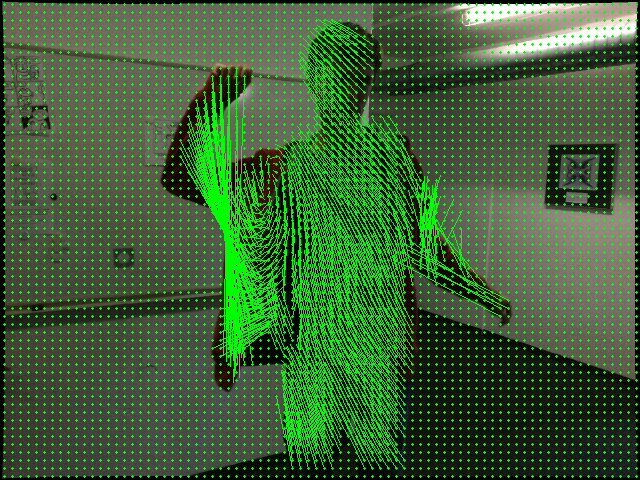

input


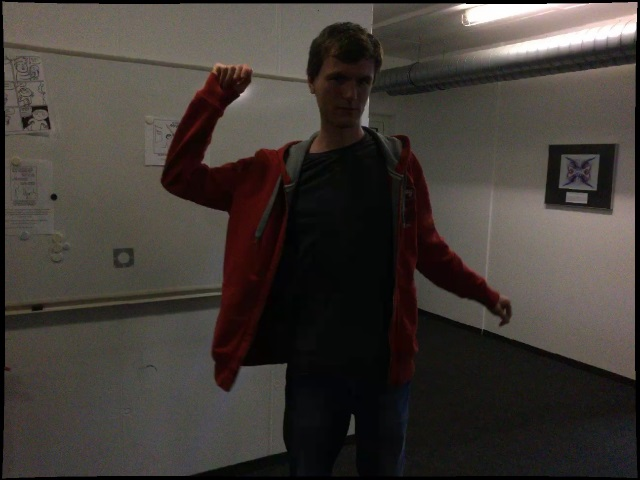

expected


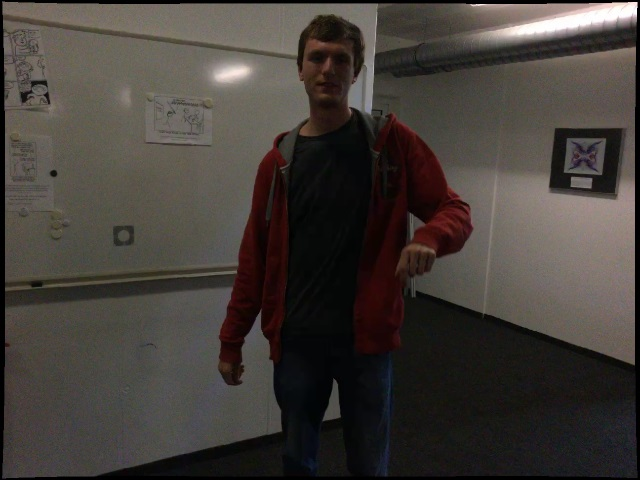



forwards
forwards warped


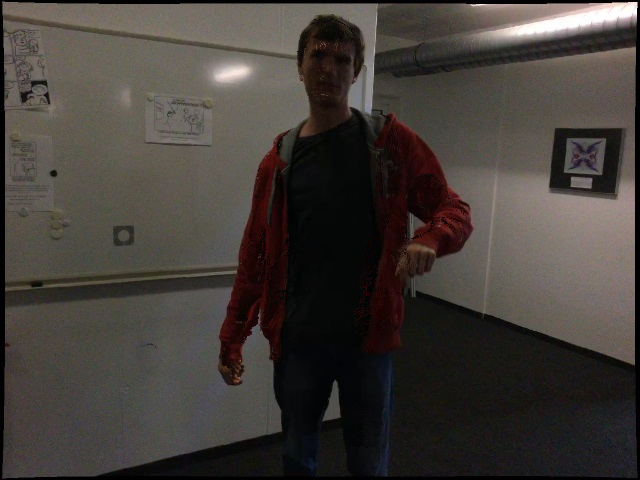

expected


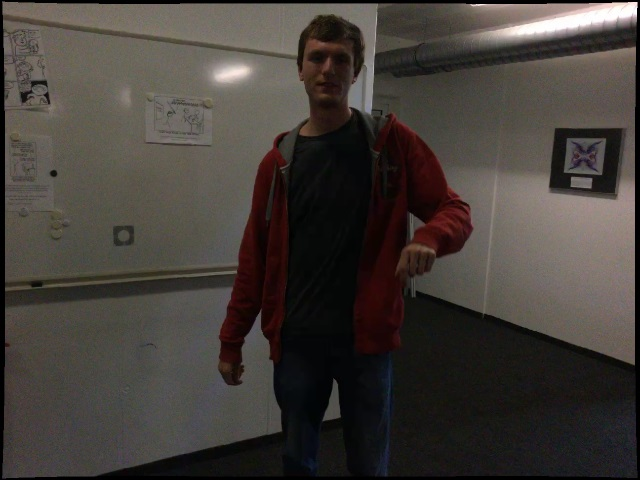

mse 29.70838080769718
rmse 5.450539496939471
psnr -14.728789821488242
ssim 0.741581076693612
edges_mse 417.1766



backwards
warped


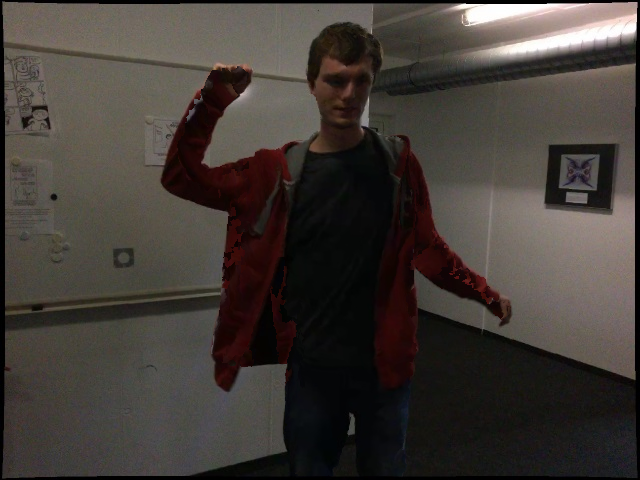

input


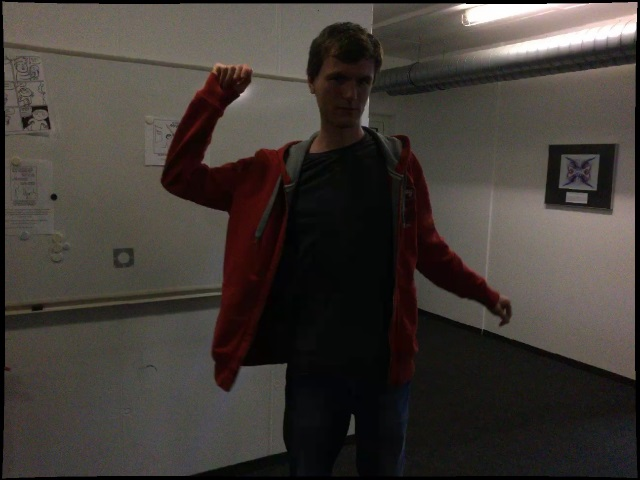

MSE 31.379196023727335
RMSE 5.601713668488183
PSNR -14.966418121976432
SSIM 0.7123039901388738
Flow Coverage 0.20652018229166666
(63443,)


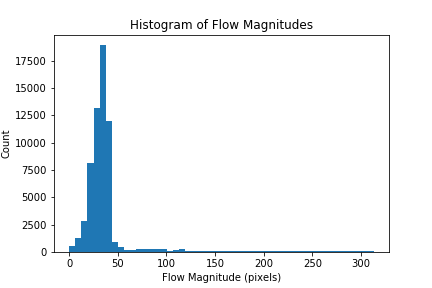


flow


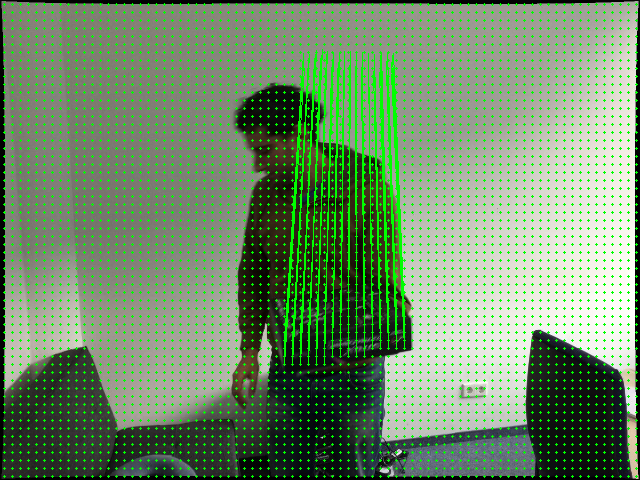

input


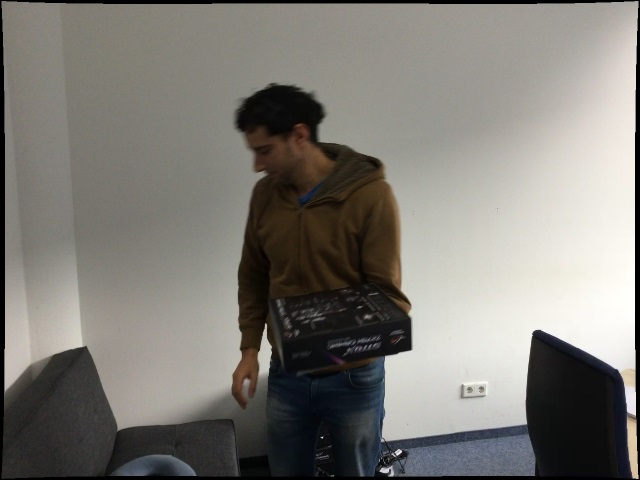

expected


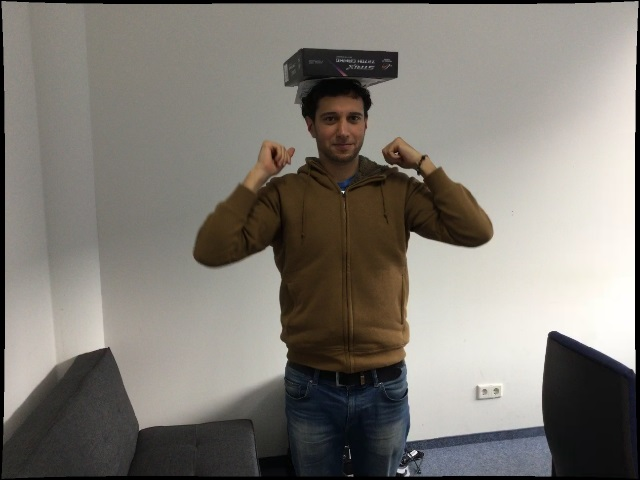



forwards
forwards warped


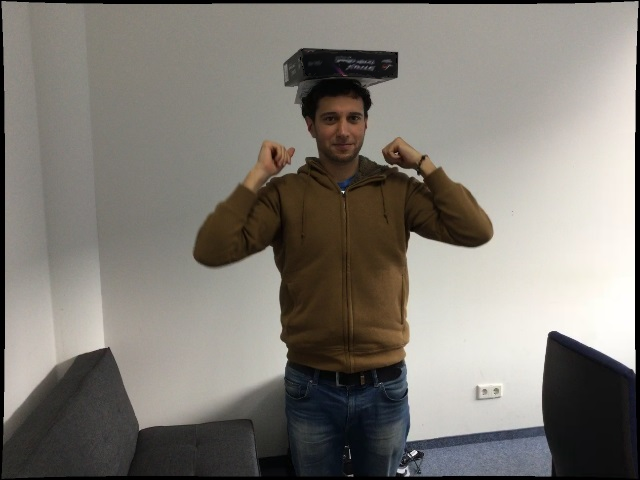

expected


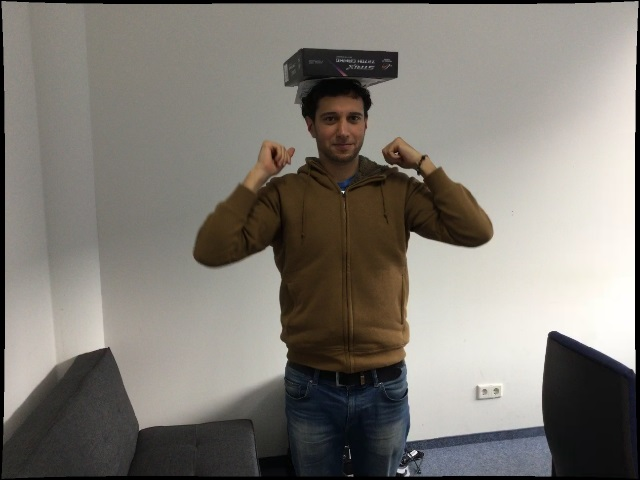

mse 99.94941920305837
rmse 9.997470640269887
psnr -19.997802748159195
ssim 0.43161211947489864
edges_mse 2622.8374



backwards
warped


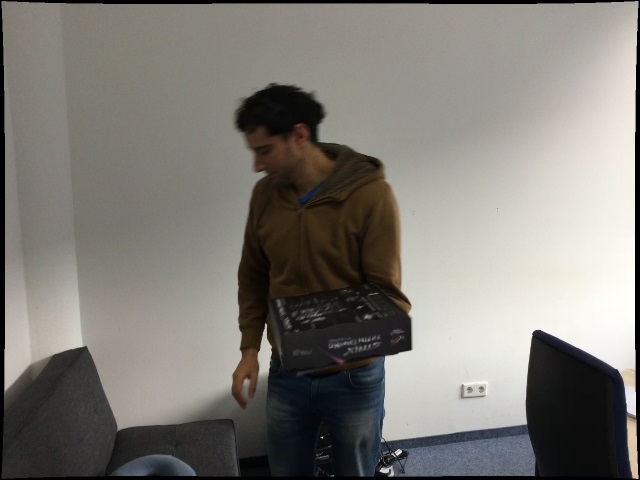

input


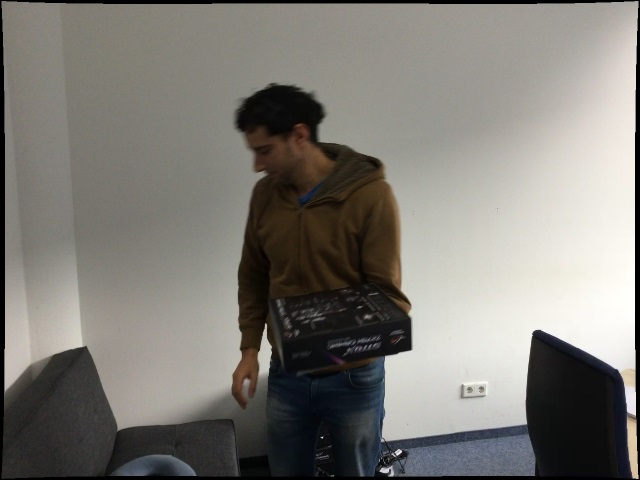

MSE 99.45145357042055
RMSE 9.972534962105701
PSNR -19.97611135102479
SSIM 0.5859264183571369
Flow Coverage 0.015377604166666666
(4724,)


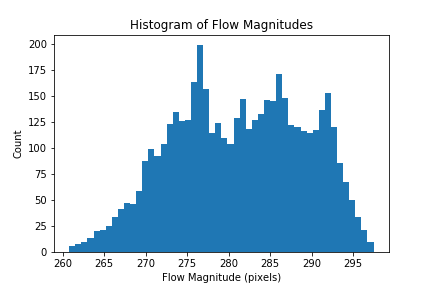


flow


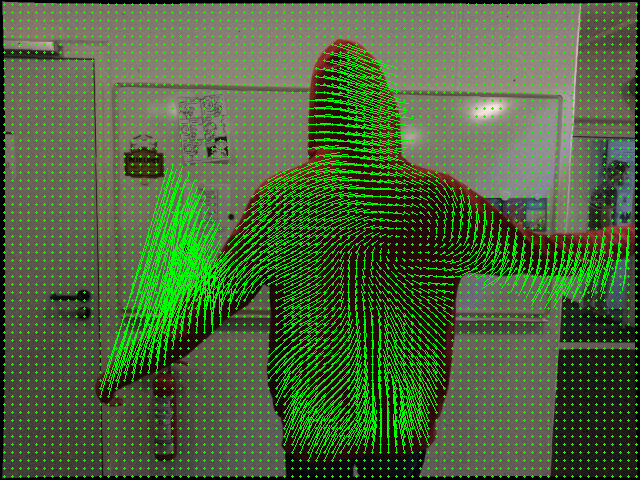

input


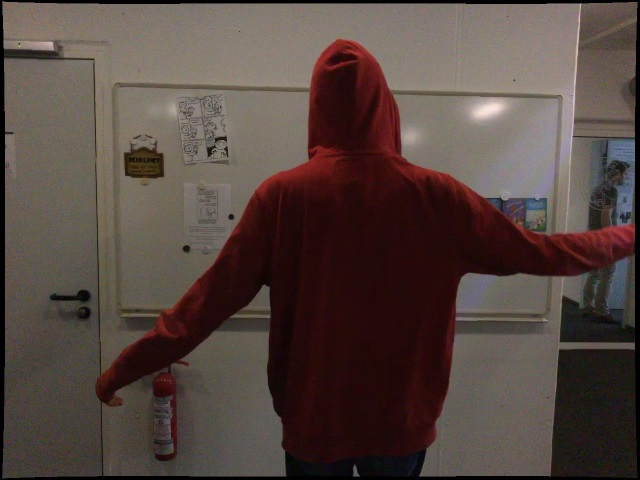

expected


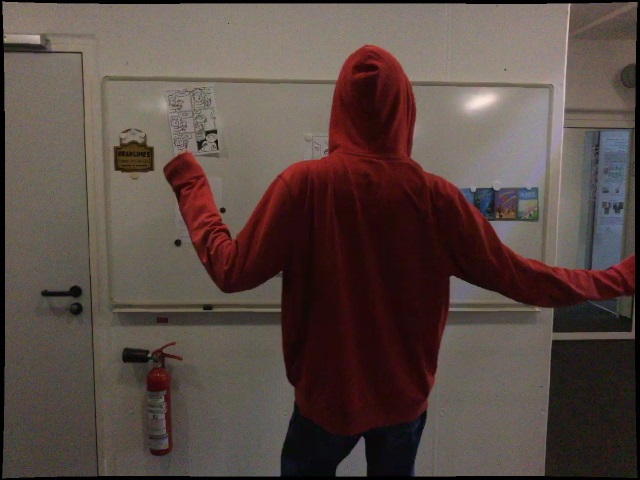



forwards
forwards warped


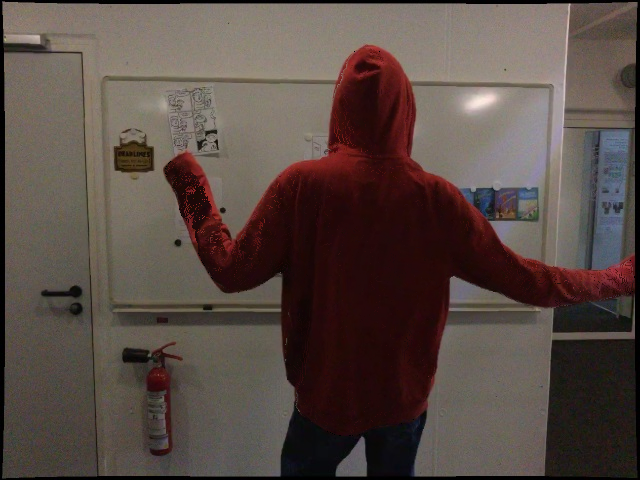

expected


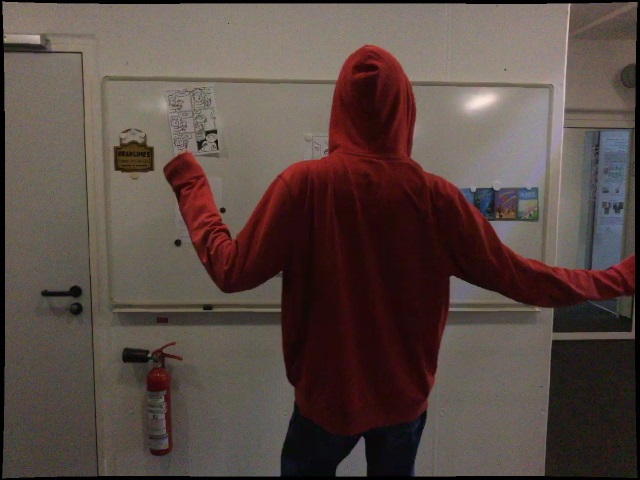

mse 35.088024169733316
rmse 5.9235145116504375
psnr -15.45158913489233
ssim 0.7450175135697711
edges_mse 378.75656



backwards
warped


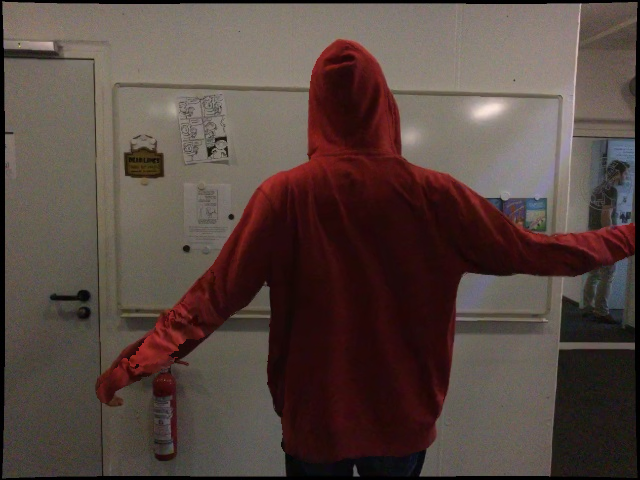

input


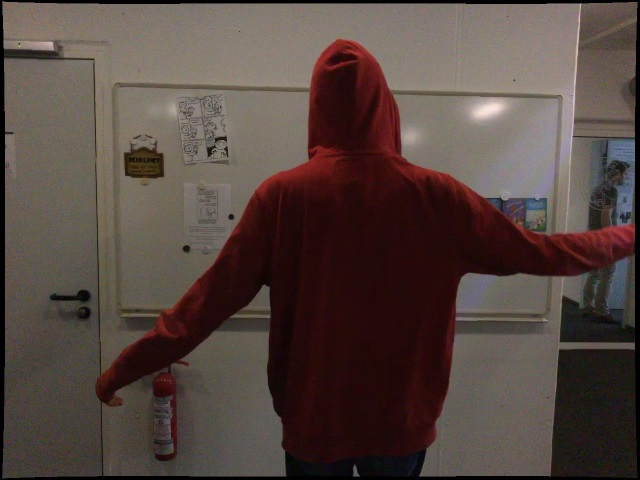

MSE 34.49261261715419
RMSE 5.873041172778732
PSNR -15.377260909240993
SSIM 0.7562350779726382
Flow Coverage 0.258291015625
(79347,)


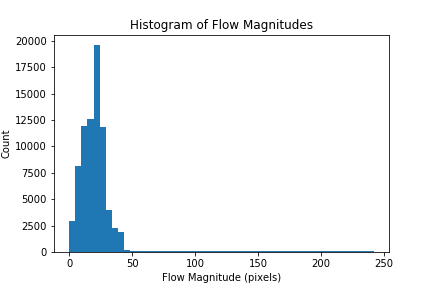


flow


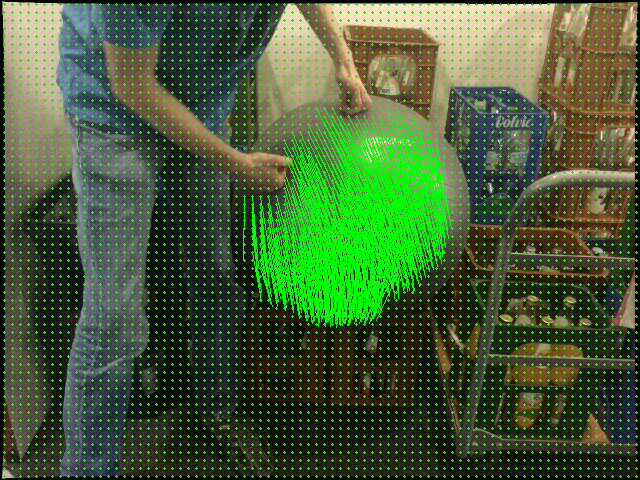

input


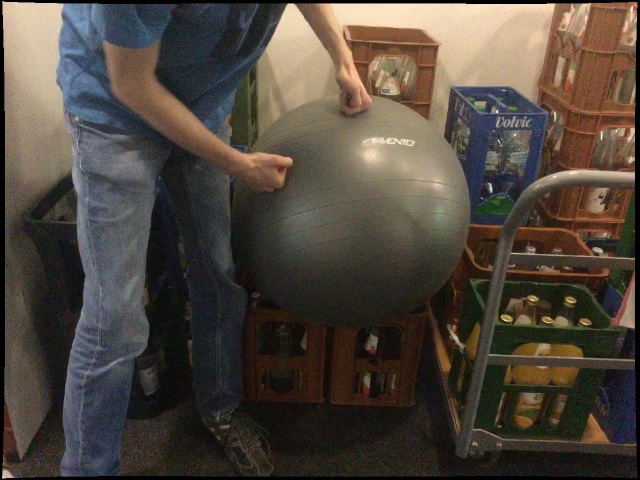

expected


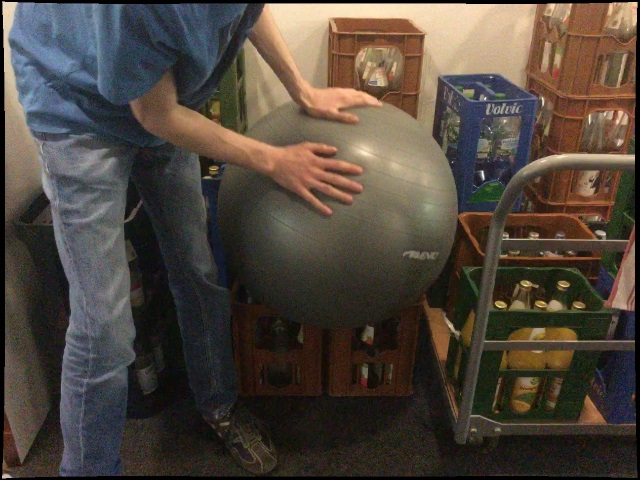



forwards
forwards warped


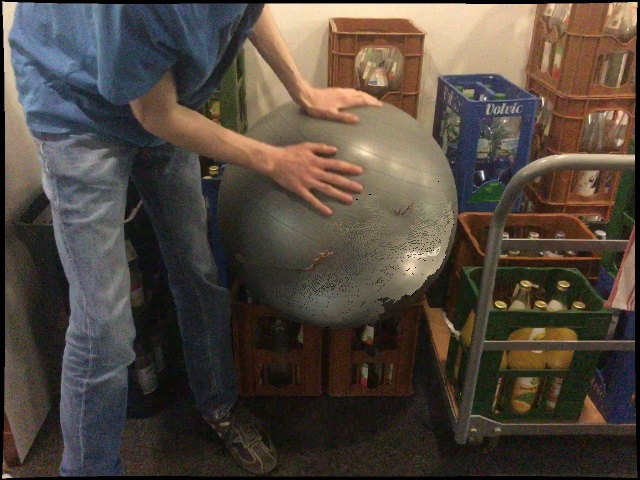

expected


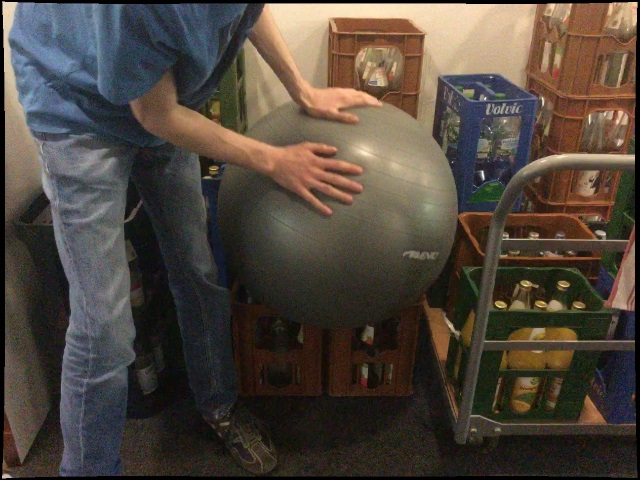

mse 103.82402421709662
rmse 10.189407451716542
psnr -20.162978581144767
ssim 0.38526811939180844
edges_mse 1534.4601



backwards
warped


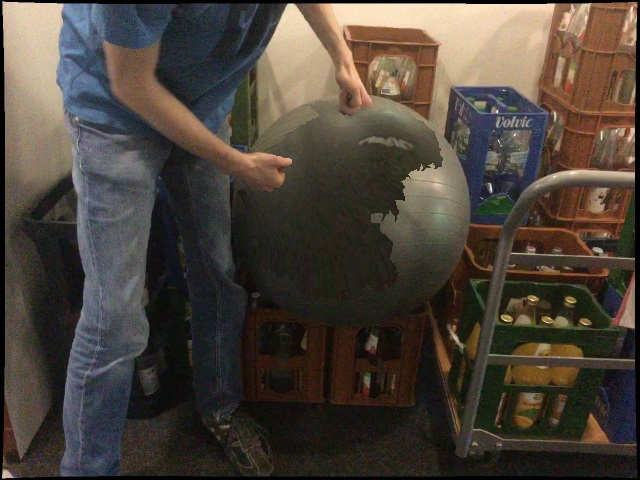

input


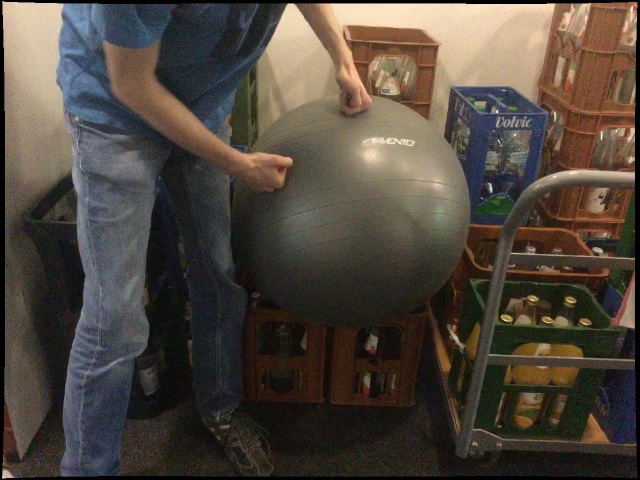

MSE 103.78686973670185
RMSE 10.18758409715973
PSNR -20.161424136127124
SSIM 0.41132783120700317
Flow Coverage 0.08143229166666667
(25016,)


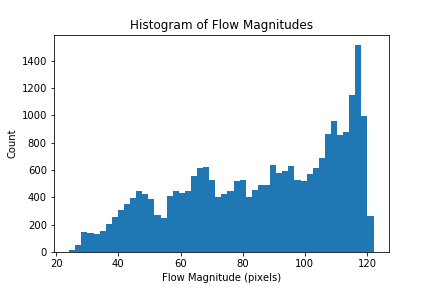


flow


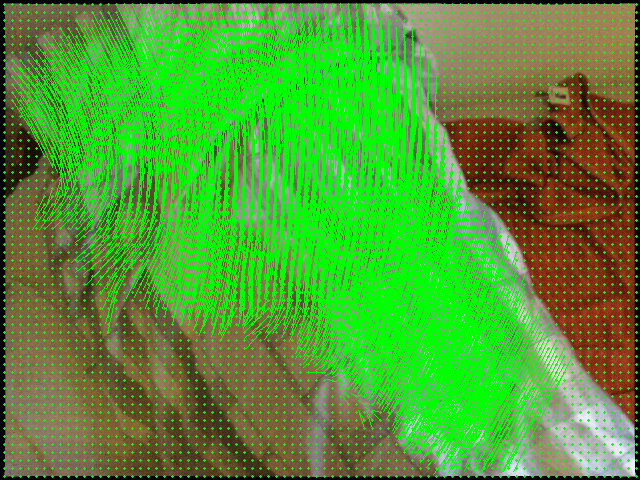

input


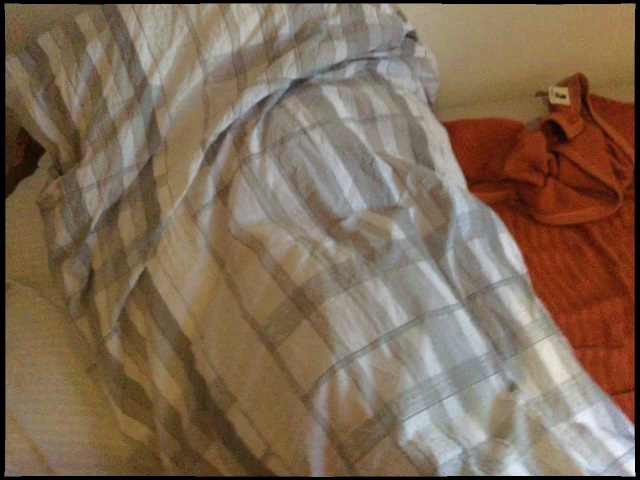

expected


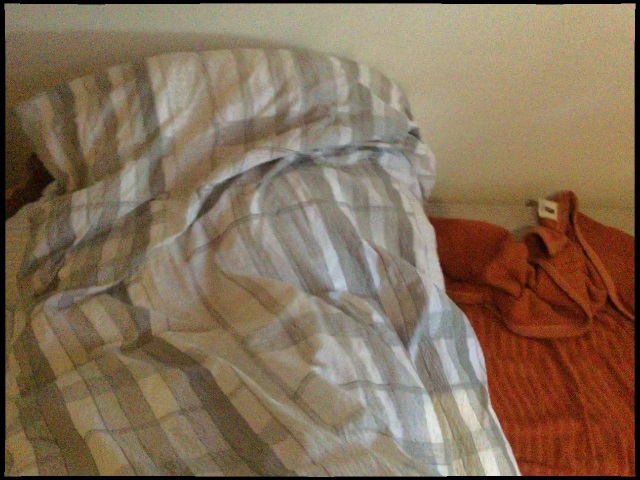



forwards
forwards warped


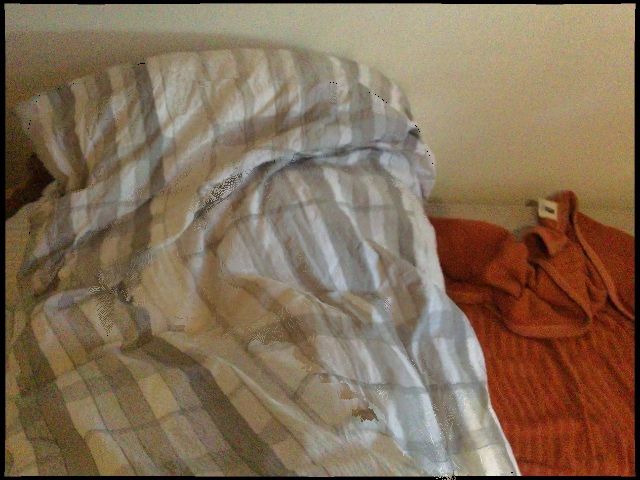

expected


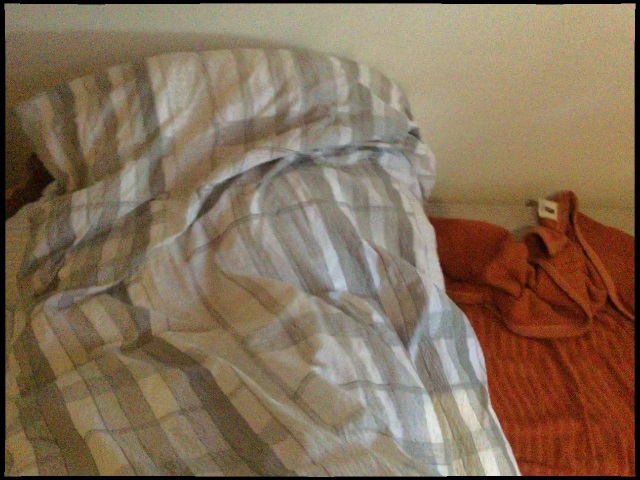

mse 67.15812254699182
rmse 8.19500595161418
psnr -18.270985466250572
ssim 0.6877717724693656
edges_mse 1077.526



backwards
warped


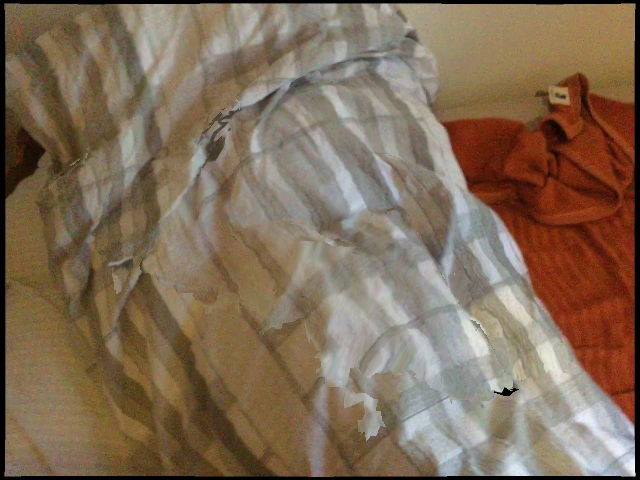

input


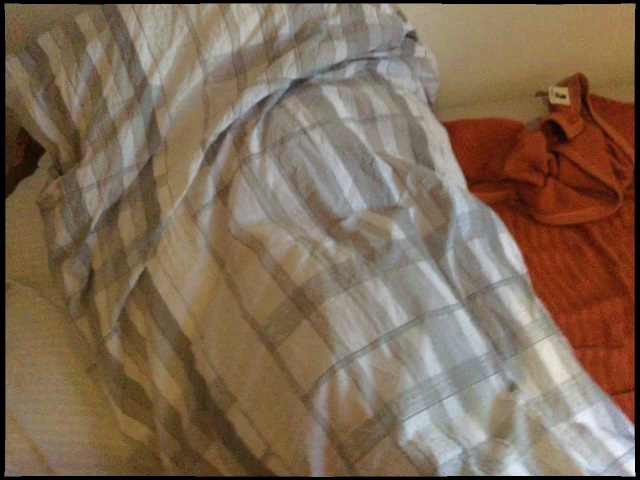

MSE 68.23157365871164
RMSE 8.260240532739445
PSNR -18.339853877450043
SSIM 0.6666813304848397
Flow Coverage 0.4535319010416667
(139325,)


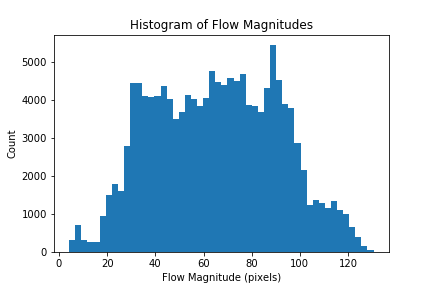


flow


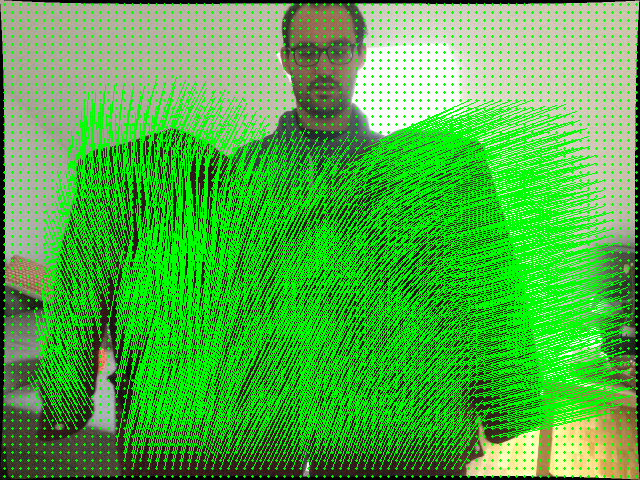

input


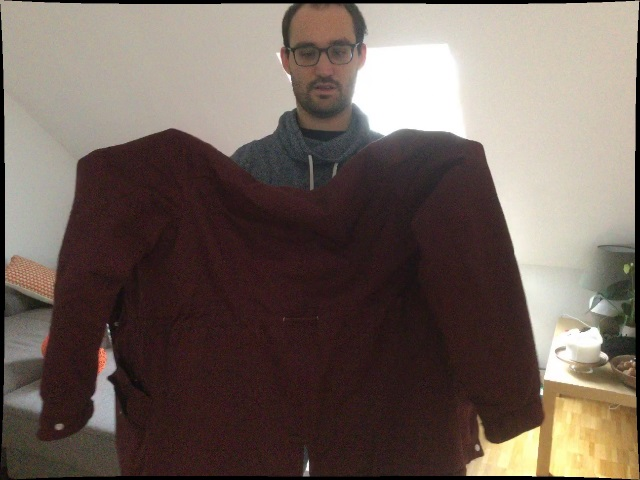

expected


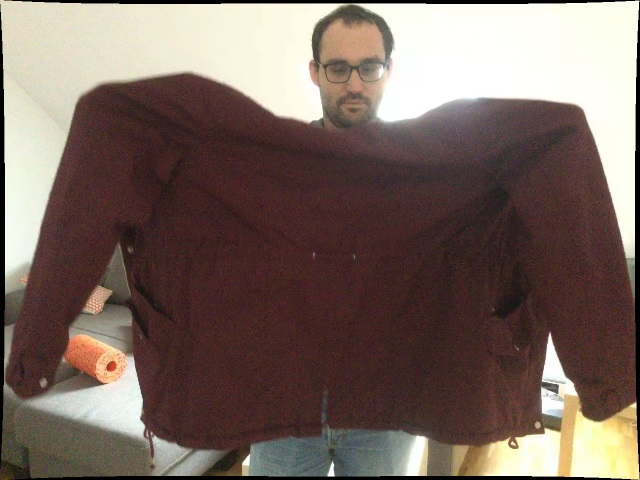



forwards
forwards warped


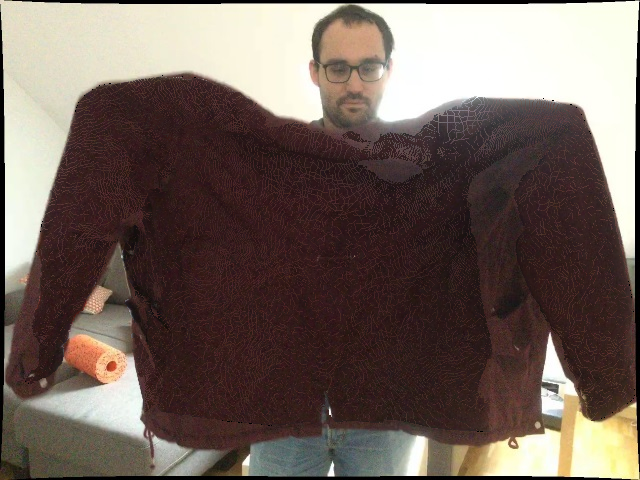

expected


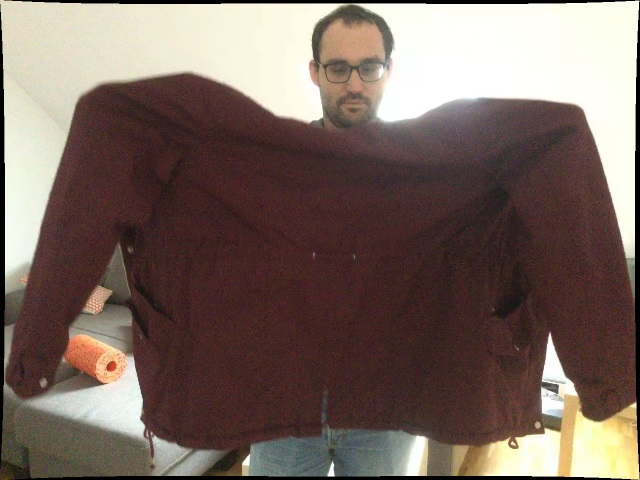

mse 102.53991102474944
rmse 10.126199238843242
psnr -20.108929362614205
ssim 0.5889510798165286
edges_mse 660.5865



backwards
warped


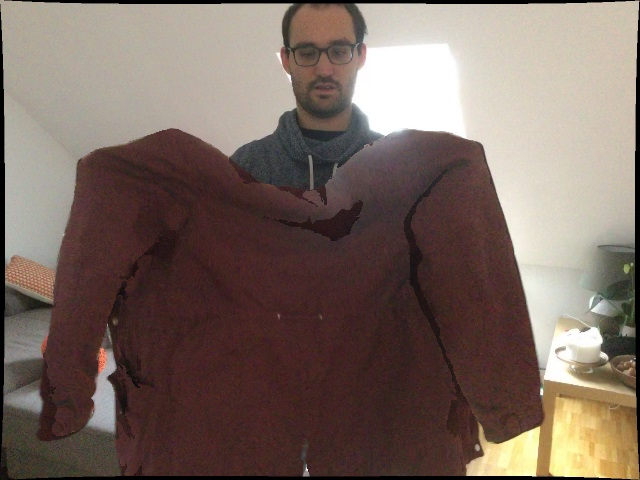

input


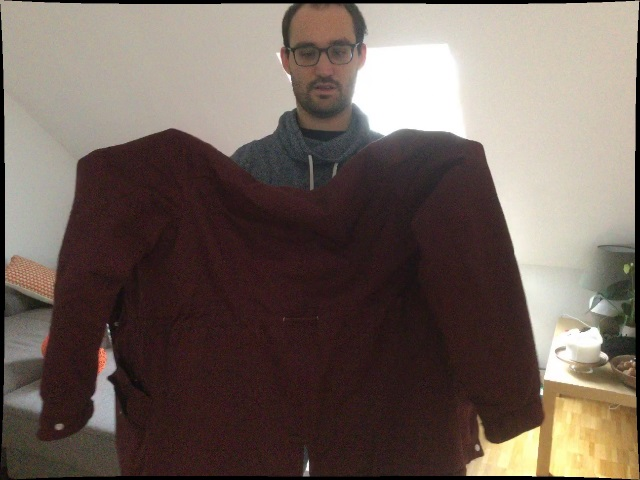

MSE 102.02137713276827
RMSE 10.100563208691298
PSNR -20.08691181546918
SSIM 0.6066808402295125
Flow Coverage 0.44433919270833333
(136501,)


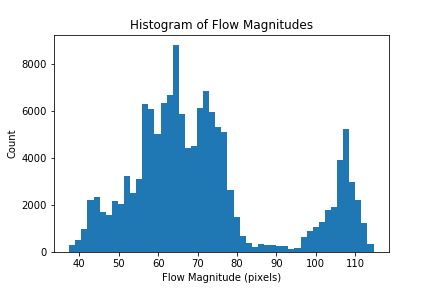

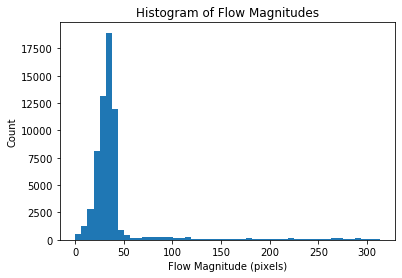

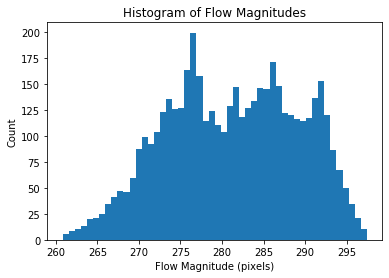

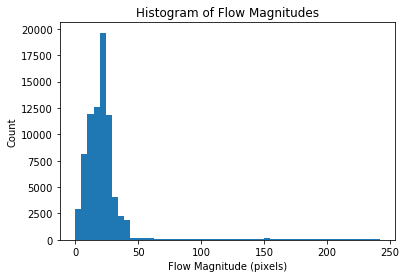

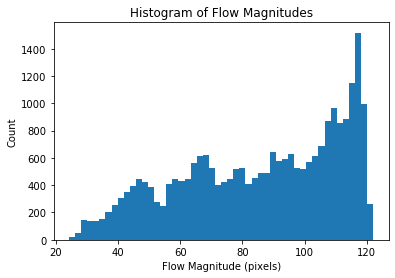

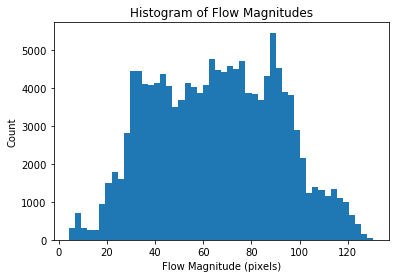

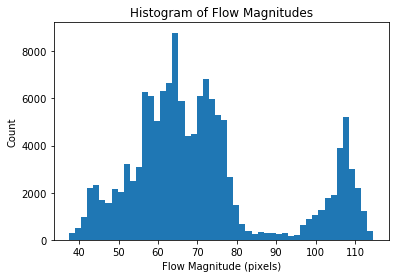

In [25]:
# https://github.com/AljazBozic/DeepDeform/blob/master/demo/demo_alignments.py

import numpy as np

def dd_utils_load_flow(filename):
    # https://github.com/AljazBozic/DeepDeform/blob/master/utils.py#L1
    import os
    import shutil
    import numpy as np
    import struct
    # Flow is stored row-wise in order [channels, height, width].
    assert os.path.isfile(filename), "File not found: {}".format(filename)

    flow = None
    with open(filename, 'rb') as fin:
        width = struct.unpack('I', fin.read(4))[0]
        height = struct.unpack('I', fin.read(4))[0]
        channels = struct.unpack('I', fin.read(4))[0]
        n_elems = height * width * channels

        flow = struct.unpack('f' * n_elems, fin.read(n_elems * 4))
        flow = np.asarray(flow, dtype=np.float32).reshape([channels, height, width])

    return flow

def dd_load_flow(path):
    flow_gt = dd_utils_load_flow(path)
    flow_gt = np.moveaxis(flow_gt, 0, -1) # (h, w, 2)
    invalid_flow = flow_gt == -np.Inf
    flow_gt[invalid_flow] = 0.0
    return flow_gt

DD_DATA_ROOT = '/outer_root/media/seagates-ext4/au_datas/deepdeform_v1'

# See train_alignments.json
# DD_SCENES = [
#     {
#         "input": "train/seq000/color/000000.jpg",
#         "expected_out": "train/seq000/color/000200.jpg",
#         "flow_gt": "train/seq000/optical_flow/blackdog_000000_000200.oflow",
#     },
    
#     {
#         "input": "train/seq000/color/000000.jpg",
#         "expected_out": "train/seq000/color/001200.jpg",
#         "flow_gt": "train/seq000/optical_flow/blackdog_000000_001200.oflow",
#     },
    
#     {
#         "input": "train/seq001/color/003400.jpg",
#         "expected_out": "train/seq001/color/003600.jpg",
#         "flow_gt": "train/seq001/optical_flow/lady_003400_003600.oflow",
#     },
    
#     {
#         "input": "train/seq337/color/000050.jpg",
#         "expected_out": "train/seq337/color/000350.jpg",
#         "flow_gt": "train/seq337/optical_flow/adult_000050_000350.oflow",
#     },
# ]

import json
alignments = json.load(open(os.path.join(DD_DATA_ROOT, 'train_alignments.json')))
DD_SCENES = [
    {
        "input": ascene['source_color'],
        "expected_out": ascene['target_color'],
        "flow_gt": ascene['optical_flow'],
    }
    for ascene in alignments
]

import random
myrand = random.Random(1337)
myrand.shuffle(DD_SCENES)

for i, scene in enumerate(DD_SCENES[:25]):
    if i not in (0,2,5,15,16,21):
        continue
    
    img_in = imageio.imread(os.path.join(DD_DATA_ROOT, scene['input']))
    expected = imageio.imread(os.path.join(DD_DATA_ROOT, scene['expected_out']))
    flow_gt = dd_load_flow(os.path.join(DD_DATA_ROOT, scene['flow_gt']))
    
    show_scene(img_in, expected, flow_gt, dataset='deepdeform', exname=str(i))
    continue
    
    vis = draw_flow(img_in, flow_gt)
    imshow(vis)

    warped = warp_flow(img_in, flow_gt[:, :, :2])
    imshow(warped)
    
    exclude = (flow_gt == np.array([0, 0])).all(axis=-1)
    warped[exclude] = np.array([0, 0, 0])
    imshow(warped)
    
    imshow(expected)



# KITTI 360 ? -- geolocalized

In [313]:
# next paper

psegs sceneflow: semantic kitti

we will start today and not do nusc yet, so ignore moving things for now

In [72]:
## Semantic KITTI Support
import numpy as np
import os

def maybe_make_homogeneous(pts, dim=3):
  """Convert numpy n-by-d array `pts` to Homogeneous coordinates of target
  `dim` if necessary"""
  if pts.shape[-1] != (dim + 1):
    pts = np.hstack((pts, np.ones((pts.shape[0], 1))))
  return pts

# TODO: cite semantic kitti code
def parse_calibration(filename):
  """ read calibration file with given filename
      Returns
      -------
      dict
          Calibration matrices as 4x4 numpy arrays.
  """
  calib = {}

  calib_file = open(filename)
  for line in calib_file:
    key, content = line.strip().split(":")
    values = [float(v) for v in content.strip().split()]

    pose = np.zeros((4, 4))
    pose[0, 0:4] = values[0:4]
    pose[1, 0:4] = values[4:8]
    pose[2, 0:4] = values[8:12]
    pose[3, 3] = 1.0

    calib[key] = pose

  calib_file.close()

  return calib

def parse_poses(filename, calibration):
  """ read poses file with per-scan poses from given filename
      Returns
      -------
      list
          list of poses as 4x4 numpy arrays.
  """
  file = open(filename)

  poses = []

  Tr = calibration["Tr"]
#   print('Tr', Tr)
#   Tr = np.array([[1, 0, 0, 0], [0, 1, 0, 0], [0, 0, 1, 0], [0, 0, 0, 1]])
  Tr_inv = np.linalg.inv(Tr)

  for line in file:
    values = [float(v) for v in line.strip().split()]

    pose = np.zeros((4, 4))
    pose[0, 0:4] = values[0:4]
    pose[1, 0:4] = values[4:8]
    pose[2, 0:4] = values[8:12]
    pose[3, 3] = 1.0

    poses.append(np.matmul(Tr_inv, np.matmul(pose, Tr)))
#     poses.append(np.matmul(pose, Tr))
  file.close()
  return poses



## PSEGS


def color_to_opencv(color):
  r, g, b = np.clip(color, 0, 255).astype(int).tolist()
  return b, g, r

def rgb_for_distance(d_meters, period_meters=10.):
  """Given a distance `d_meters` or an array of distances, return an
  `np.array([r, g, b])` color array for the given distance (or a 2D array
  of colors if the input is an array)).  We choose a distinct hue every
  `period_meters` and interpolate between hues for `d_meters`.
  """
  from oarphpy.plotting import hash_to_rbg

  if not isinstance(d_meters, np.ndarray):
    d_meters = np.array([d_meters])
  
  SEED = 10 # Colors for 0 and 1 look too similar otherwise
  max_bucket = int(np.ceil(d_meters.max() / period_meters))
  bucket_to_color = np.array(
    [hash_to_rbg(bucket + SEED) for bucket in range(max_bucket + 2)])

  # Use numpy's indexing for fast "table lookup" of bucket ids (bids) in
  # the "table" bucket_to_color
  bucket_below = np.floor(d_meters / period_meters)
  bucket_above = bucket_below + 1

  color_below = bucket_to_color[bucket_below.astype(int)]
  color_above = bucket_to_color[bucket_above.astype(int)]

  # For each distance, interpolate to *nearest* color based on L1 distance
  d_relative = d_meters / period_meters
  l1_dist_below = np.abs(d_relative - bucket_below)
  l1_dist_above = np.abs(d_relative - bucket_above)

  colors = (
    (1. - l1_dist_below) * color_below.T + 
    (1. - l1_dist_above) * color_above.T)

  colors = colors.T
  if len(d_meters) == 1:
    return colors[0]
  else:
    return colors

def draw_xy_depth_px_in_image(img, pts, alpha=.7):
  """
  new!
  Draw a point cloud `pts` in `img`. Point color interpolates between
  standard colors for each 10-meter tick.

  Args:
    img (np.array): Draw in this image.
    pts (np.array): An array of N by 3 points in form
      (pixel x, pixel y, depth meters).
    dot_size (int): Size of the dot to draw for each point.
    alpha (float): Blend point color using weight [0, 1].
  """

  import cv2

  # OpenCV can't draw transparent colors, so we use the 'overlay image' trick:
  # First draw dots an an overlay...
  overlay = img.copy()

  pts = pts.copy()
  pts = pts[-pts[:, -1].argsort()]
    # short by distance descending; let colors of nearer points
    # override colors of farther points
  print(pts.shape)

  colors = rgb_for_distance(pts[:, 2])
  print(colors.shape)
  colors = np.clip(colors, 0, 255).astype(int)
  print(colors.shape)
  for i, ((x, y), color) in enumerate(zip(pts[:, :2].tolist(), colors.tolist())):
    x = int(round(x))
    y = int(round(y))
    if y >= overlay.shape[0] or x >= overlay.shape[1]:
        continue
    overlay[y, x, :] = color
#     print(color)
    
    if i > 0 and ((i % 500000) == 0):
        print(i, flush=True)

  # Now blend!
  img[:] = cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0)











## Common Support

# collect img1, pose1
# collect img2, pose2
# collect all clouds (save in RAM)
# collect all labels / cuboids

def make_homo(cloud):
    if cloud.shape[-1] == 4:
        return cloud
    else:
        out = np.ones((cloud.shape[0], 4))
        out[:, :3] = cloud[:, :3]
        return out

def compute_optical_flows(
        t1_i=0, img1=None, 
        t2_i=1, img2=None,
        pose1=None,
        pose2=None,
        fused_world_cloud=None, # pre-filter these to remove moving stuff !!
        all_moving_objs=[],
        all_moving_clouds_t1t2=[],
        P=None,
        T_lidar2cam=None,
        T_ego2lidar=None):
    
    h, w, c = img1.shape
    
    pose1 = np.linalg.inv(pose1) # FIXME for Semantic KITTI
    pose2 = np.linalg.inv(pose2) # FIXME for Semantic KITTI
    print('diff Tx_pose1->Tx_pose2', pose2[:, -1] - pose1[:, -1])
    
    hfused_world_cloud = make_homo(fused_world_cloud)
    is_moving_ignore = np.zeros((hfused_world_cloud.shape[0], 1))
    
    if len(all_moving_clouds_t1t2):
        # Add all moving things at t1 and t2 to environment; we'll mask them
        m1 = all_moving_clouds_t1t2[0]
        m2 = all_moving_clouds_t1t2[1]
        hfused_world_cloud = np.vstack([
            hfused_world_cloud,
            make_homo(m1),
            make_homo(m2),
        ])
        is_moving_ignore = np.vstack([
            is_moving_ignore,
            np.ones((m1.shape[0], 1)),
            np.ones((m2.shape[0], 1)),
        ])
    
    
    def world_to_uvdij_visible_t(pose):
        xyz_ego_t = np.matmul(pose, hfused_world_cloud.T)
        print('xyz_ego_t mean min max', np.mean(xyz_ego_t, axis=1), np.min(xyz_ego_t, axis=1), np.max(xyz_ego_t, axis=1))
        uvd = P.dot(T_lidar2cam.dot( T_ego2lidar.dot( xyz_ego_t ) ) )
        uvd[0:2, :] /= uvd[2, :]
        uvd = uvd.T
        uvd = uvd[:, :3]
        ij = np.rint(uvd[:, (0, 1)]) # Group by rounted pixel coord; need orig (u, v) for sub-pixel flow
        uvdij = np.hstack([uvd, ij])

        in_cam_frustum = np.where(
                (uvdij[:, 0] >= 0) & 
                (uvdij[:, 0] <= w - 1) &
                (uvdij[:, 1] >= 0) & 
                (uvdij[:, 1] <= h - 1) &
                (uvdij[:, 2] >= 0.01))

        uvdij_in_cam = uvdij[in_cam_frustum]

        
        print('render using pandas %s ...' % (uvdij_in_cam.shape,))
        import pandas as pd
        import time
        start = time.time()
        df = pd.DataFrame(uvdij_in_cam[:, 2:], columns=['d', 'i', 'j'])
        df['id'] = df.index
        nearest_idx = df.groupby(['i', 'j'])['d'].idxmin().to_numpy()
        print(time.time() - start, 'done pandas, %s winners' % (nearest_idx.shape,))
        
        uvdij_visible = np.hstack([uvdij, np.zeros((uvdij.shape[0], 1))])
        idx = np.arange(uvdij_visible.shape[0])[in_cam_frustum][nearest_idx]
        uvdij_visible[idx, -1] += 1
           # visible: in the camera frustum, AND is nearest point for the pixel.
           # then we'll flow from that pt. TODO: try to average flows for a single pixel?

        if len(all_moving_clouds_t1t2):
            uvdij_visible[np.where(is_moving_ignore == 1)[0], -1] = 0
        
        return uvdij_visible
        
        
    uvdij_visible1 = world_to_uvdij_visible_t(pose1)
    uvdij_visible2 = world_to_uvdij_visible_t(pose2)
    
    if True:
        debug = img1.copy()
        draw_xy_depth_px_in_image(debug, uvdij_visible1[uvdij_visible1[:, -1] == 1][:, :3])
        print('project1')
        imshow(debug)
        
        debug = img2.copy()
        draw_xy_depth_px_in_image(debug, uvdij_visible2[uvdij_visible2[:, -1] == 1][:, :3])
        print('project2')
        imshow(debug)
    
    visible_both = ((uvdij_visible1[:, -1] == 1) & (uvdij_visible2[:, -1] == 1))
    
    visboth_uv1 = uvdij_visible1[visible_both, :2]
    visboth_uv2 = uvdij_visible2[visible_both, :2]
    ij_flow = np.hstack([
      uvdij_visible1[visible_both, 3:5], visboth_uv2 - visboth_uv1
    ])
    v2v_flow = np.zeros((h, w, 2))
    xx = ij_flow[:, 0].astype(np.int)
    yy = ij_flow[:, 1].astype(np.int)
    v2v_flow[yy, xx] = ij_flow[:, 2:4]
    
    v2o_flow = np.zeros((h, w, 2)) # ignore for now
    o2v_flow = np.zeros((h, w, 2)) # ignore for now
    return v2v_flow, v2o_flow, o2v_flow
    
    # build array, each row is a 3d point at times t1 and t2
    # xyz t1 | xyz t2 | (is_moving - are xyz diff?) | img1 uvd | img2 uvd | is visible img1 | is visible img2
    # ** for moving stuff, careful to append correct xyz ...
    # ** for semantic kitti, need to make moving stuff verboten at both timesteps ...
    
    # then compute:
    # vis change | uvd img1 | uvd img2
    
    # the break that above into 3 flows
    
    # create fused unproj for img1
    # place moving objs for img1
    
    # create fused unproj for img2
    # place moving objs for img2
    
    
    
    
    

In [36]:
import time
import numpy as np
import os
SCENE_BASE = '/outer_root/media/seagates-ext4/au_datas/kitti/odom_tmp/dataset/sequences/03/'
last_vel = max(os.listdir(SCENE_BASE + '/velodyne/'))
N_SCANS = int(last_vel.replace('.bin', ''))
print('N_SCANS', N_SCANS)

# https://github.com/PRBonn/semantic-kitti-api/blob/c2d7712964a9541ed31900c925bf5971be2107c2/auxiliary/SSCDataset.py#L20
SPLIT_SEQUENCES = {
    "train": ["00", "01", "02", "03", "04", "05", "06", "07", "09", "10"],
    "valid": ["08"],
    "test": ["11", "12", "13", "14", "15", "16", "17", "18", "19", "20", "21"]
}

SEMANTIC_KITTI_MOVING_LABELS = [
    252,# "moving-car"
    253,# "moving-bicyclist"
    254,# "moving-person"
    255,# "moving-motorcyclist"
    256,# "moving-on-rails"
    257,# "moving-bus"
    258,# "moving-truck"
    259,# "moving-other-vehicle"
]

calib = parse_calibration(os.path.join(SCENE_BASE, 'calib.txt'))
all_poses = parse_poses(os.path.join(SCENE_BASE, "poses.txt"), calib)

start = time.time()
static_clouds = []
all_moving_clouds = [np.array([])] * N_SCANS
all_scanids = []
frames_no_movers = []
for s in range(N_SCANS):#0, 1500):#N_SCANS-100):# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    scan_name = str(s).rjust(6, '0')
    path = os.path.join(SCENE_BASE, 'velodyne', scan_name + '.bin')
    lidar = np.frombuffer(open(path, 'rb').read(), dtype=np.float32).reshape((-1, 4))
    scloud = np.ones(lidar.shape)  # need homogenous for change below
    scloud[:, 0:3] = lidar[:, 0:3]

    labels_path = os.path.join(SCENE_BASE, 'labels', scan_name + '.label')
    labels = np.fromfile(labels_path, dtype=np.uint32)
    labels = labels.reshape((-1))
    sem_label = labels & 0xFFFF  # semantic label in lower half
    inst_label = labels >> 16    # instance id in upper half
     #22 / 252 is chase car in scene 08 !!!
    
    pose = all_poses[s]
    scloud = np.matmul(pose, scloud.T).T
    
    moving_mask = np.logical_or.reduce(tuple((sem_label == c) for c in SEMANTIC_KITTI_MOVING_LABELS))
    if not moving_mask.any():
        frames_no_movers.append(s)
    static_cloud = scloud[~moving_mask][:, :3]
    moving_cloud = scloud[moving_mask][:, :3]
    
    static_clouds.append(static_cloud)
    all_moving_clouds[s] = moving_cloud
    if s % 100 == 0:
        print(str(s) + '...', end='', flush=True)
    all_scanids.append(s)
print('done in ', time.time() - start)
        
fused_world_cloud = np.vstack(static_clouds)

# idx = np.random.randint(fused_world_cloud.shape[0], size=100000)
# fused_world_cloud = fused_world_cloud[idx, :]


del static_clouds
print('fused_world_cloud', fused_world_cloud.shape, fused_world_cloud.nbytes * 1e-9, 'GBytes')
n_moving_pts = sum(c.shape[0] for c in all_moving_clouds)
print('moving_cloud pts', n_moving_pts, float(n_moving_pts) / fused_world_cloud.shape[0])
print('frames_no_movers', frames_no_movers[:20])

N_SCANS 800
0...100...200...300...400...500...600...700...done in  67.25542831420898
fused_world_cloud (99099902, 3) 2.378397648 GBytes
moving_cloud pts 77553 0.0007825739323132731
frames_no_movers [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 14, 15, 16, 17, 21, 22, 23, 240, 241]


In [ ]:
from random import Random
myRandom = Random(1337)
all_ids = [s for s in all_scanids if s != N_SCANS - 1]
myRandom.shuffle(all_ids)

sample_ids = all_ids[:1]
for s in sample_ids:
    s = 29
    t1 = s
    t2 = s + 1
    scan_name1 = str(t1).rjust(6, '0')
    scan_name2 = str(t2).rjust(6, '0')

    import imageio
    img1 = imageio.imread(os.path.join(SCENE_BASE, 'image_2/', scan_name1 + '.png'))
    img2 = imageio.imread(os.path.join(SCENE_BASE, 'image_2/', scan_name2 + '.png'))
    
    moving_1 = all_moving_clouds[t1]
    moving_2 = all_moving_clouds[t2]
    
    pose1 = all_poses[t1]
    pose2 = all_poses[t2]
    
    v2v_flow, v2o_flow, o2v_flow = compute_optical_flows(
                                        t1_i=t1,   img1=img1,
                                        t2_i=t2,   img2=img2,
                                        pose1=pose1,
                                        pose2=pose2,
                                        fused_world_cloud=fused_world_cloud,
                                        all_moving_objs=[],
                                        all_moving_clouds_t1t2=[moving_1, moving_2],
                                        P=calib['P2'],
                                        T_lidar2cam=calib['Tr'],
                                        T_ego2lidar=np.eye(4))

    print(v2v_flow.shape, v2o_flow.shape, o2v_flow.shape)
    
    show_scene(img1, img2, v2v_flow, dataset='kitti_ours', exname=str(s))
    

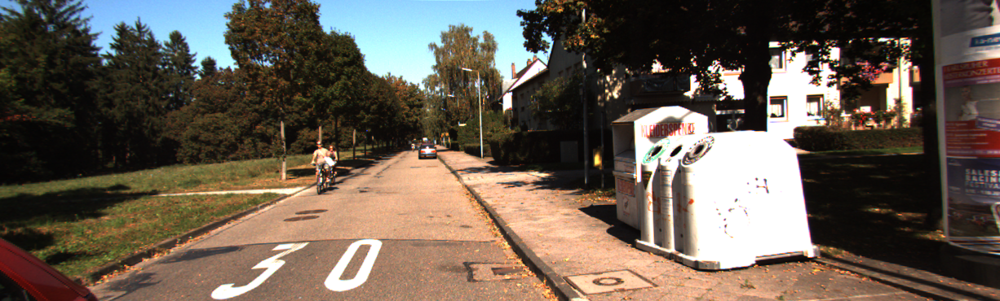

In [208]:
imshow(imageio.imread(os.path.join(SCENE_BASE, 'image_2/', str(77).rjust(6, '0') + '.png')))

In [ ]:
NuScenes testing

diff Tx_pose1->Tx_pose2 [-24.99203835 -83.76799757  20.84365556   0.        ]
xyz_ego_t mean min max [30.98022398  0.04604619  2.04192062  1.        ] [-113.7716299  -115.15943513  -40.28240453    1.        ] [168.49861677 100.27781857  24.2023392    1.        ]
render using pandas (7474303, 5) ...
53.53797960281372 done pandas, (561424,) winners
xyz_ego_t mean min max [27.81776263  1.41880955  1.61368474  1.        ] [-115.88437085 -116.24424495  -39.26052616    1.        ] [167.04285552 101.16578717  24.81695321   1.        ]
render using pandas (7095179, 5) ...
53.83764839172363 done pandas, (557763,) winners
(551227, 3)
(551227, 3)
(551227, 3)
500000
project1


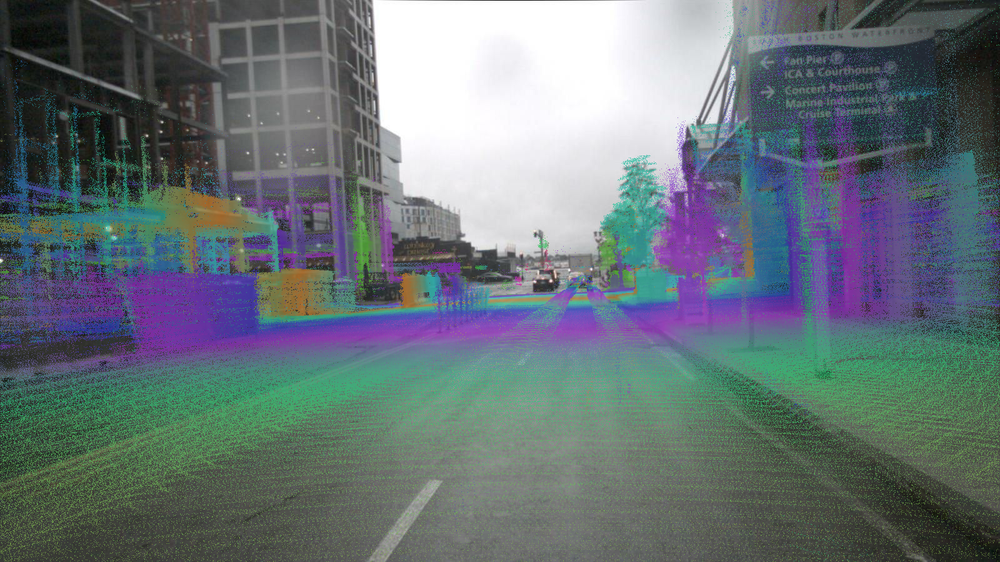

(552320, 3)
(552320, 3)
(552320, 3)
500000
project2


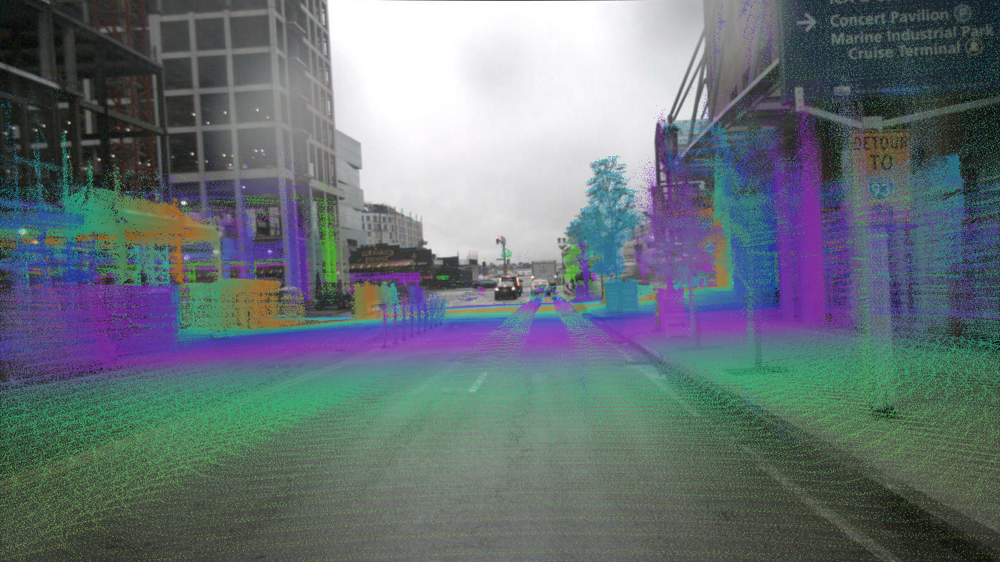

(900, 1600, 2) (900, 1600, 2) (900, 1600, 2)

flow


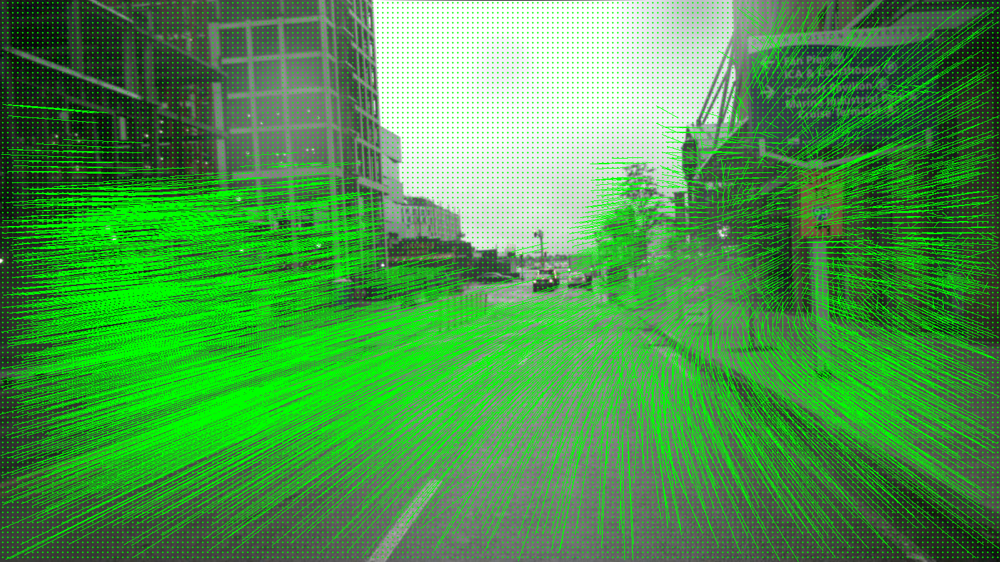

input


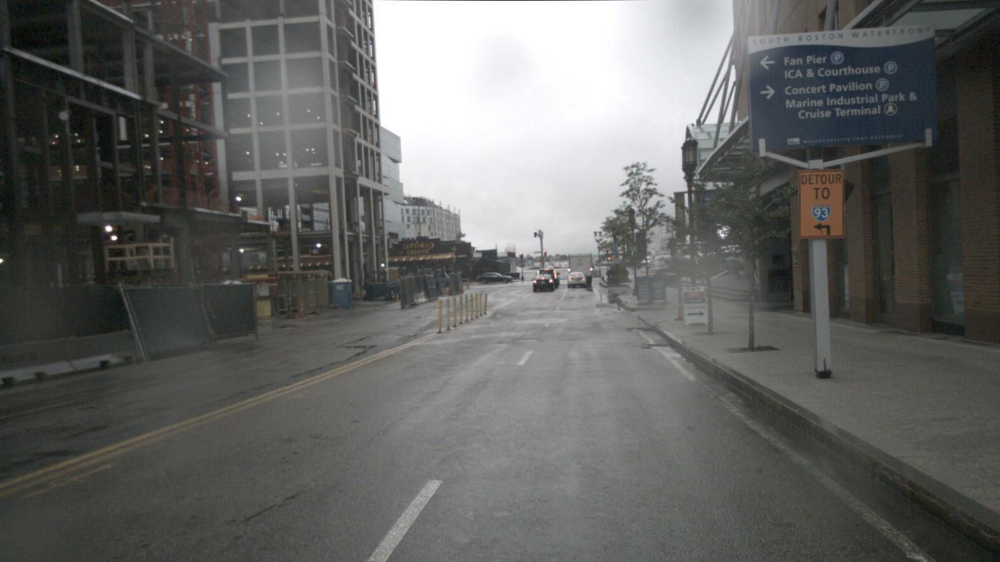

expected


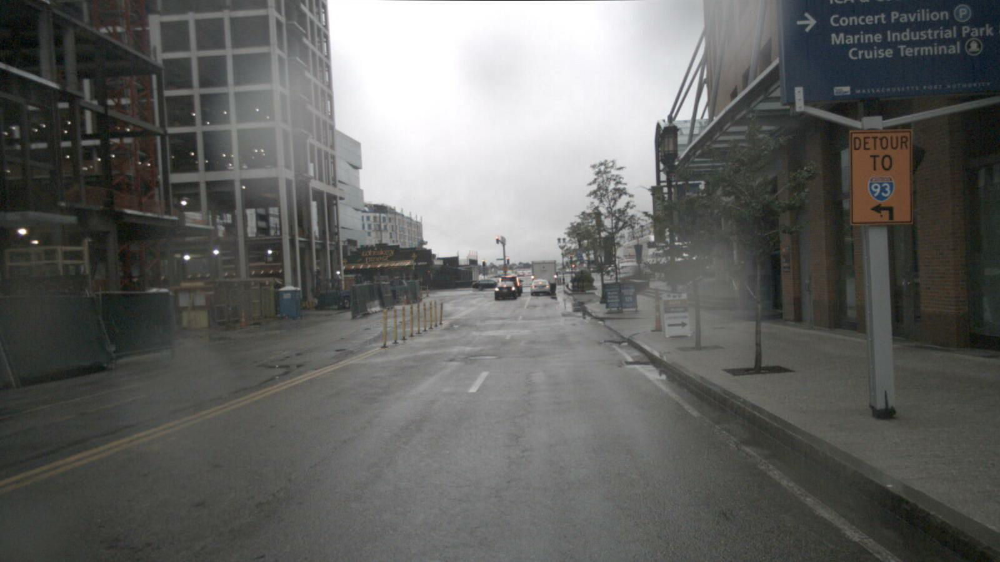



forwards
forwards warped


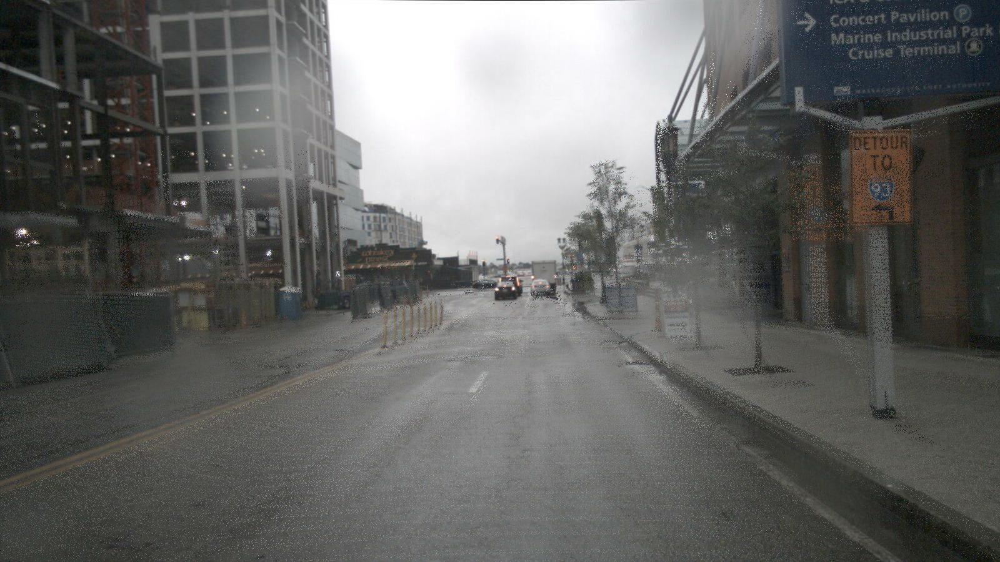

expected


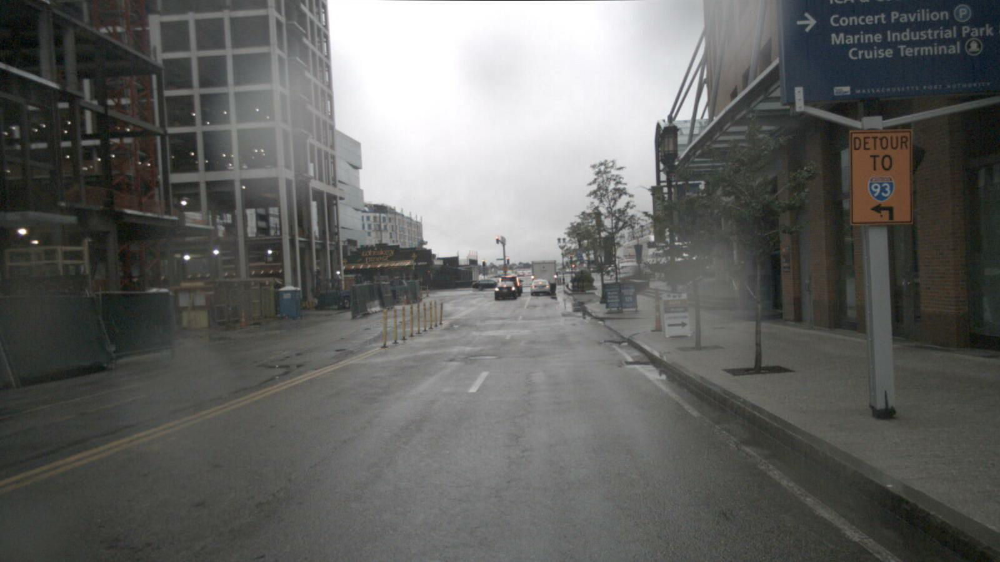

mse 86.58823310675135
rmse 9.305279851071184
psnr -19.374588776521875
ssim 0.5426017750637423
edges_mse 1263.1079



backwards
warped


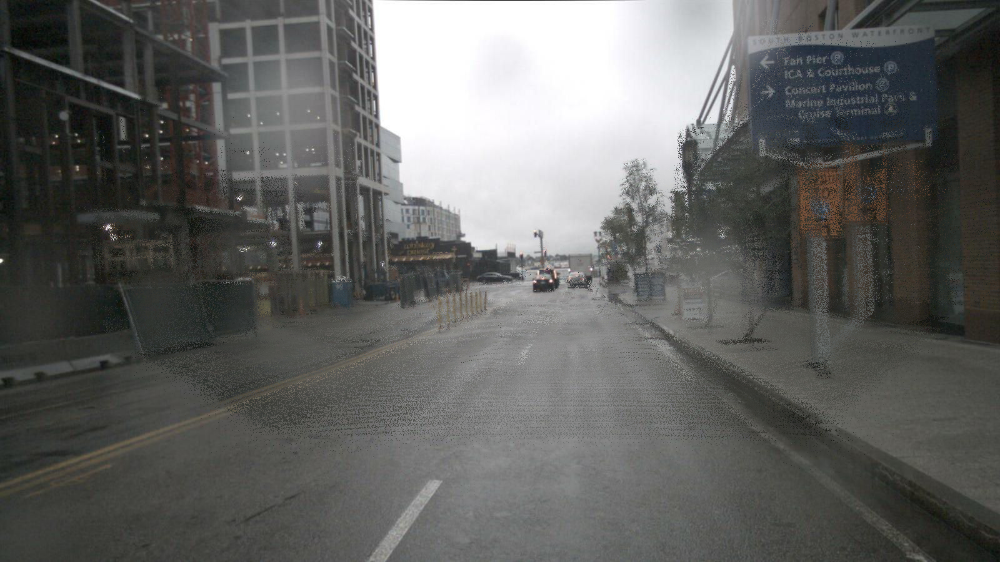

input


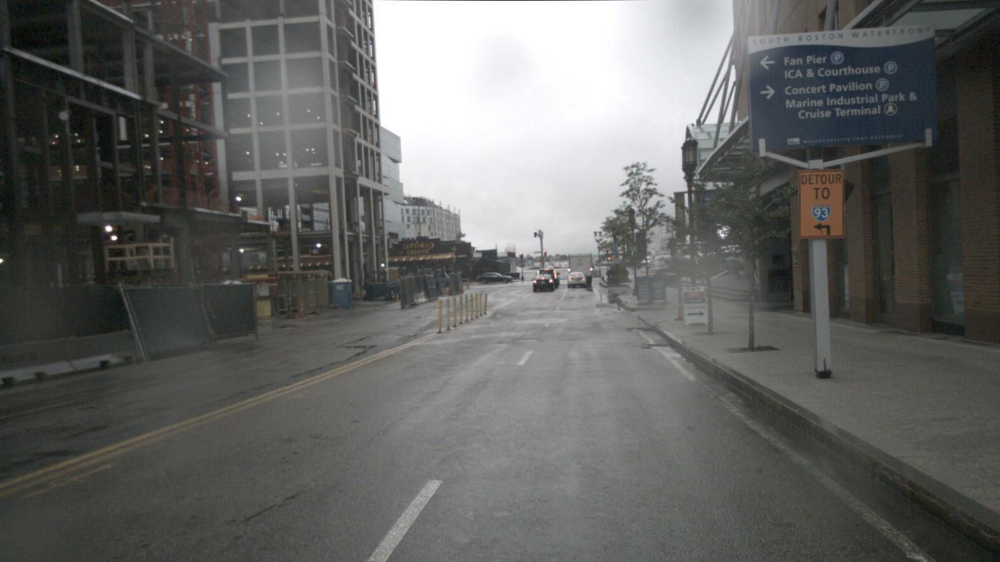

MSE 88.01268880700813
RMSE 9.381507810954918
PSNR -19.445452889866303
SSIM 0.3125320718698033
Flow Coverage 0.19921319444444444
(286867,)


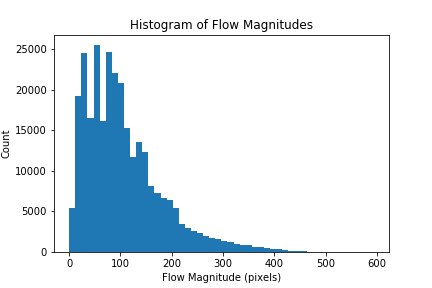

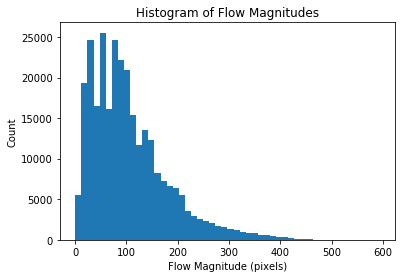

In [86]:
import pickle
import numpy as np

fname = 'pair_CAM_FRONT_1537292948404799000_1537292948904799000.pkl'
path = '/outer_root/media/alalbaicin/temp_out/' + fname
data = pickle.load(open(path, 'rb'))

kwargs = data
kwargs['all_moving_objs'] = []

v2v_flow, v2o_flow, o2v_flow = compute_optical_flows(**kwargs)

print(v2v_flow.shape, v2o_flow.shape, o2v_flow.shape)

show_scene(data['img1'], data['img2'], v2v_flow, dataset='nuscenes_ours', exname=fname)